# Veri Yoğun Uygulamalar Modül Projesi: Zaman Serisi Sınıflandırma Problemi
Dr. İsmail Güzel

Milli Teknoloji Hamlesi kapsamında düzenlenen Yapay Zeka Uzmanlık Programı dahilinde, 18 saatlik Veri Yoğun Uygulamalar Eğitimi sonunda bu projenin tamamlanması beklenmektedir.

### **Proje Başlığı: Hisse Senetlerinin Sektörel Benzerlik Analizi ve Sınıflandırma Modeli Geliştirilmesi**

#### **Proje Amacı:**
Farklı sektörlerdeki hisse senetlerinin zaman serisi davranışlarını analiz ederek, bir hisse senedinin hangi sektöre daha çok benzediğini tespit etmek ve bu bilgiyi yatırım stratejileri için kullanmak.

---

#### **Proje Adımları:**

1. **Veri Toplama:**
   - `yfinance`, `investpy`, `quandl` gibi kütüphaneler kullanılarak, 2005-01-01 tarihinden itibaren aylık getirilere sahip hisse senetleri ve sektör verileri toplanacak.
   - Web scraping ile sektörlerin ve hisse senetlerinin listesi çekilecek.

2. **Veri Ön İşleme:**
   - **Boş Değer Doldurma:** Eksik veriler, ortalama, medyan veya ileri/geri doldurma (forward/backward fill) yöntemleriyle doldurulabilir.
   - **Dönüşüm Kullanma:** Zaman serisi verileri için log dönüşümü, fark alma (differencing) gibi yöntemler uygulanarak verinin durağanlık (stationary) özelliği kazanması sağlanabilir.
   - **Kategorik Değişkenlerle Çalışma:** Sektör bilgisi gibi kategorik değişkenler, one-hot encoding veya label encoding yöntemleriyle sayısal hale getirilebiilir.
   - **Ölçeklendirme:** Zaman serisi verileri ve özellikler, standardizasyon (StandardScaler) veya normalizasyon (MinMaxScaler) yöntemleriyle ölçeklendirilebilir.

3. **Öznitelik Çıkarımı ve Seçme:**
   - **Öznitelik Çıkarımı:** `tsfresh` kütüphanesi ile otomatik özellik çıkarımı yapılacak. Bu süreçte, zaman serisi verilerinden istatistiksel özellikler (ortalama, standart sapma, otokorelasyon vb.) çıkarılacak.
   - **Öznitelik Seçme:** Çıkarılan özellikler arasından en önemlileri seçmek için L1 regularization (Lasso), Recursive Feature Elimination (RFE) veya Principal Component Analysis (PCA) gibi yöntemler kullanılabilir.

4. **Model Geliştirme:**
   - **Model Seçimi:** Scikit-learn, XGBoost ve CatBoost kütüphaneleri kullanılarak Random Forest, Gradient Boosting ve XGBoost modelleri denenerek en iyi performans gösteren model seçilecek.
   - **Hiperparametre Optimizasyonu:** Grid Search veya Bayesian Optimization yöntemleriyle hiperparametre optimizasyonu yapılacak.
   - **Cross-Validation:** Modelin genelleme performansını artırmak için cross-validation yöntemleri kullanılacak.

5. **Model Değerlendirme:**
   - Doğruluk (accuracy), F1-score, ROC-AUC gibi metrikler kullanılarak model performansı değerlendirilecek.
   - Backtesting ile modelin geçmiş veriler üzerindeki performansı test edilebilir, zorunlu değildir.

6. **Sektörel Benzerlik Analizi:**
   - Bir hisse senedinin hangi sektöre daha çok benzediği tespit edilebilir.
   - Örneğin, Real-Estate sektöründeki hisse senetlerinin çoğunlukla hangi sektöre benzediği analiz edilecek.

7. **Bonus: Faktör Hesaplama ve İleri Analiz:**
   - **Faktör Hesaplama:** Model performansı orijinal seri üzerinden yeterli gelmezse, momentum, volatilite, RSI, MACD gibi finansal faktörler hesaplanabilir.
   - **Faktör Zaman Serileri Üzerinden Analiz:** Faktör zaman serileri üzerinden aynı işlemler tekrarlanarak model performansı artırılmaya çalışılabilir. Karşılaştırma yapılabilir.

8. **Sonuçların Görselleştirilmesi ve Raporlama:**
   - Zaman serisi grafikleri, sektörel benzerlik matrisleri ve model performans metrikleri görselleştirilecek.
   - Proje sonuçları detaylı bir rapor halinde sunulacak.

---

#### **Beklenen Çıktılar:**
- Hisse senetlerinin sektörel benzerliklerini gösteren bir sınıflandırma modeli.
- Farklı sektörlerdeki hisse senetlerinin davranışlarını açıklayan bir analiz raporu.
- Yatırım stratejileri için kullanılabilecek sektörel benzerlik bilgisi.

---

#### **Kullanılacak Araçlar ve Teknolojiler:**
- **Programlama Dili:** Python
- **Kütüphaneler:** `yfinance`, `investpy`, `quandl`, `tsfresh`, `scikit-learn`, `XGBoost`, `CatBoost`, `Matplotlib`, `Seaborn`, `Plotly`
- **Veri Kaynakları:** Borsa verileri, sektörel endeksler, finansal API'lar

---

#### **Proje Süresi:**
- **Tahmini Süre:** 10 gün (veri toplama, model geliştirme, test ve raporlama dahil)

#### **Proje Teslimi:**
- E-posta: ismail.guzel@tubitak.gov.tr
- E-posta başlığı: **YZUP-VYU-Proje-isim-soyisim**
- Dosya ismi: **YZUP-VYU-Proje-isim-soyisim.ipynb**
- Drive bağlantısı paylaşabilirsiniz.

**Colab üzerinde çalışabilmek için mount işlemi**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import yfinance
import pandas as pd
import requests
from bs4 import BeautifulSoup
from io import StringIO

def fetch_sectors_names():
    url = "https://stockanalysis.com/stocks/industry/sectors/"
    response = requests.get(url)
    if response.status_code == 200:
        soup = BeautifulSoup(response.content, "html.parser")
        df=pd.read_html(StringIO(str(soup.find_all("table"))))[0]
    else:
        print(f"Error: Failed to fetch data from page {url}")

    return df

def fetch_industry_names():
    url = "https://stockanalysis.com/stocks/industry/all/"
    response = requests.get(url)
    if response.status_code == 200:
        soup = BeautifulSoup(response.content, "html.parser")
        df=pd.read_html(StringIO(str(soup.find_all("table"))))[0]
    else:
        print(f"Error: Failed to fetch data from page {url}")

    return df

def fetch_data(sectors):
    url = f"https://stockanalysis.com/stocks/sector/{sectors}/"
    response = requests.get(url)
    if response.status_code == 200:
        soup = BeautifulSoup(response.content, "html.parser")
        df=pd.read_html(StringIO(str(soup.find_all("table"))))[0]
        df.drop(columns='No.', inplace=True)
    else:
        print(f"Error: Failed to fetch data from page {url}")

    return df

In [ ]:
sectors=fetch_sectors_names()
indusrty=fetch_industry_names()

In [ ]:
sectors

,Sector Name,Stocks,Market Cap,Div. Yield,PE Ratio,Profit Margin,1D Change,1Y Change
0,Financials,1276,11.95T,0.17%,15.94,20.02%,-0.38%,34.68%
1,Healthcare,1157,"7,984.09B",0.50%,61.03,3.08%,-0.01%,9.05%
2,Technology,770,21.76T,0.49%,46.35,14.60%,-0.03%,42.25%
3,Industrials,666,"5,903.34B",1.20%,29.30,7.26%,-0.83%,23.92%
4,Consumer Discretionary,561,"8,748.73B",0.77%,29.28,6.51%,-0.04%,33.37%
5,Materials,265,"2,030.92B",1.73%,27.25,6.40%,0.01%,14.57%
6,Real Estate,262,"1,672.25B",3.85%,49.73,9.40%,-0.78%,12.89%
7,Energy,251,"3,629.04B",3.18%,13.40,8.15%,-2.12%,13.07%
8,Communication Services,248,"6,908.22B",1.40%,30.58,11.72%,0.19%,38.12%
9,Consumer Staples,243,"4,303.92B",1.51%,29.85,4.95%,0.31%,29.42%


## Sektör listerine erişmek

Yukarıdaki fonksiyonlar yardımıyla, hangi sembollerin hangi sektörlere ait olduğu bilgisine erişim sağlanabilir ve bu bilgiler ```.csv``` dosyalarına kaydedilebilir. Daha sonra, bu ```.csv``` dosyaları kullanılarak sektör bazlı sembollere ait veriler indirilebilir ve sınıflandırılabilir. Bu süreç, finansal analizlerde sektör bazlı karşılaştırmalar yapmak veya belirli sektörlerdeki trendleri incelemek için oldukça faydalıdır.

In [ ]:
!mkdir -p /content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors

In [ ]:
fetch_data(sectors='energy').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/energy.csv')
fetch_data(sectors='financials').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/financials.csv')
fetch_data(sectors='healthcare').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/healthcare.csv')
fetch_data(sectors='technology').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/technology.csv')
fetch_data(sectors='utilities').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/utilities.csv')
fetch_data(sectors='real-estate').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/real-estate.csv')
fetch_data(sectors='materials').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/materials.csv')
fetch_data(sectors='technology').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/technology.csv')
fetch_data(sectors='industrials').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/industrials.csv')
fetch_data(sectors='consumer-staples').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/consumer-staples.csv')
fetch_data(sectors='consumer-discretionary').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/consumer-discretionary.csv')
fetch_data(sectors='communication-services').to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/communication-services.csv')

In [ ]:
finance = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/financials.csv')
finance.Symbol

,Symbol
0,BRK.B
1,JPM
2,V
3,MA
4,BAC
...,...
879,PAPL
880,LGHL
881,BTOG
882,BENF


## Veriye Erişmek

Diyelim ki, finans sektöründen **`HSBC`** sembolü için verileri indirmek istiyoruz. Bu işlem için **`yfinance`** kütüphanesini kullanabiliriz. Aşağıdaki adımları takip ederek veriye erişim sağlayabiliriz:

1. **Ticker Nesnesi Oluşturma**: İlk olarak, `yfinance` kütüphanesindeki `.Ticker` fonksiyonunu kullanarak bir obje oluşturabiliriz. Bu obje, ilgili sembolün (örneğin `HSBC`) verilerine erişim sağlar. Ayrıca, bu adımda sembolün doğru olup olmadığını teyit edebiliriz.

2. **Metadata Erişimi**: `.get_history_metadata()` fonksiyonu ile sembolün geçmişine ve diğer temel bilgilerine erişim sağlayabiliriz. Bu, sembolün geçerliliğini ve geçmiş performansını kontrol etmek için faydalıdır.

3. **Tarihsel Veriyi İndirme**: `.history(period='3y')` fonksiyonu ile son 3 yıla ait tarihsel fiyat verilerini indirebiliriz. Bu veri, kapanış fiyatları, hacim, en yüksek ve en düşük fiyatlar gibi bilgileri içerir.

In [ ]:
import yfinance
ticker_name = yfinance.Ticker("NVDA")
ticker_name.info

{'address1': '2788 San Tomas Expressway',
 'city': 'Santa Clara',
 'state': 'CA',
 'zip': '95051',
 'country': 'United States',
 'phone': '408 486 2000',
 'website': 'https://www.nvidia.com',
 'industry': 'Semiconductors',
 'industryKey': 'semiconductors',
 'industryDisp': 'Semiconductors',
 'sector': 'Technology',
 'sectorKey': 'technology',
 'sectorDisp': 'Technology',
 'longBusinessSummary': "NVIDIA Corporation provides graphics and compute and networking solutions in the United States, Taiwan, China, Hong Kong, and internationally. The Graphics segment offers GeForce GPUs for gaming and PCs, the GeForce NOW game streaming service and related infrastructure, and solutions for gaming platforms; Quadro/NVIDIA RTX GPUs for enterprise workstation graphics; virtual GPU or vGPU software for cloud-based visual and virtual computing; automotive platforms for infotainment systems; and Omniverse software for building and operating metaverse and 3D internet applications. The Compute & Networki

In [ ]:
ticker_name.get_history_metadata()

{'currency': 'USD',
 'symbol': 'NVDA',
 'exchangeName': 'NMS',
 'fullExchangeName': 'NasdaqGS',
 'instrumentType': 'EQUITY',
 'firstTradeDate': 917015400,
 'regularMarketTime': 1739566801,
 'hasPrePostMarketData': True,
 'gmtoffset': -18000,
 'timezone': 'EST',
 'exchangeTimezoneName': 'America/New_York',
 'regularMarketPrice': 138.85,
 'fiftyTwoWeekHigh': 153.13,
 'fiftyTwoWeekLow': 66.248,
 'regularMarketDayHigh': 139.19,
 'regularMarketDayLow': 135.5,
 'regularMarketVolume': 194448420,
 'longName': 'NVIDIA Corporation',
 'shortName': 'NVIDIA Corporation',
 'chartPreviousClose': 129.84,
 'previousClose': 135.29,
 'scale': 3,
 'priceHint': 2,
 'currentTradingPeriod': {'pre': {'timezone': 'EST',
   'start': 1739523600,
   'end': 1739543400,
   'gmtoffset': -18000},
  'regular': {'timezone': 'EST',
   'start': 1739543400,
   'end': 1739566800,
   'gmtoffset': -18000},
  'post': {'timezone': 'EST',
   'start': 1739566800,
   'end': 1739581200,
   'gmtoffset': -18000}},
 'tradingPeriods':

In [ ]:
data=ticker_name.history(period='2y')
data.tail()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2025-02-10 00:00:00-05:00,130.089996,135.000000,129.960007,133.570007,216989100,0.0,0.0
2025-02-11 00:00:00-05:00,132.580002,134.479996,131.020004,132.800003,178902400,0.0,0.0
2025-02-12 00:00:00-05:00,130.020004,132.240005,129.080002,131.139999,160278600,0.0,0.0
2025-02-13 00:00:00-05:00,131.559998,136.500000,131.169998,135.289993,197430000,0.0,0.0
2025-02-14 00:00:00-05:00,136.479996,139.250000,135.500000,138.850006,194892300,0.0,0.0


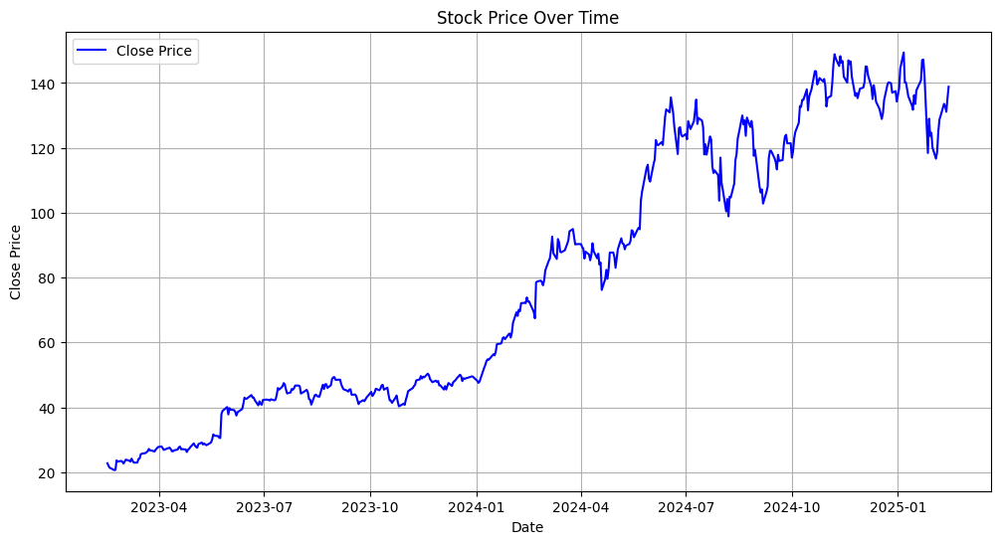

In [ ]:
import matplotlib.pyplot as plt

# Grafiği çiz
plt.figure(figsize=(12, 6))
plt.plot(data.index, data["Close"], label="Close Price", color='b')

# Başlık ve etiketler
plt.title("Stock Price Over Time")
plt.xlabel("Date")
plt.ylabel("Close Price")
plt.legend()
plt.grid()

# Grafiği göster
plt.show()


Şimdi ise, belirlenen sembollerin verilerini belirli bir tarihten itibaren çekebiliriz. Daha sonra, bu veriler **tsfresh** paketi kullanımı için uygun bir formata dönüştürülerek, özellik mühendisliği işlemlerine başlanabilir. Ek olarak, verinin kendisiyle oluşturulan model performansını iyileştirmek amacıyla farklı özellik mühendisliği çalışmaları tamamlandıktan sonra, istenilen performansa ulaşılamadığı durumda serinin orijinal değerleri yerine, göstergeler(indicators) üzerinden elde edilen serilerle bir çalışma planlanabilir. Örneğin, aylık getiriler hesaplanabilir. Proje kapsamında bu yöntem, bonus puan olarak değerlendirilecektir.

# 1) Eğitimde Kullanılacak Sektör Hisselerinin Verisinin Alınması

- Hisse isimlerini çekelim.

In [ ]:
import pandas as pd
finance_symbol = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/financials.csv').Symbol
healthcare_symbol = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/healthcare.csv').Symbol
technology_symbol = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/technology.csv').Symbol

In [ ]:
print(finance_symbol.shape)
print(healthcare_symbol.shape)
print(technology_symbol.shape)

(884,)
(1162,)
(770,)


- Her sektörde kaç adet hisse adının eksik olduğuna bakalım.

In [ ]:
# Boş (NaN) değerlerin sayısını hesaplayan fonksiyon
def count_missing_values(df, sector_name):
    missing_count = df.isna().sum().sum()
    print(f"{sector_name} sektöründe toplam {missing_count} boş değer bulunmaktadır.")

# Her sektör için boş değerleri kontrol etme
count_missing_values(finance_symbol, "Finance")
count_missing_values(healthcare_symbol, "Healthcare")
count_missing_values(technology_symbol, "Technology")


Finance sektöründe toplam 0 boş değer bulunmaktadır.
Healthcare sektöründe toplam 0 boş değer bulunmaktadır.
Technology sektöründe toplam 1 boş değer bulunmaktadır.


- Technology sektöründeki 1 adet boş değer olan sütunu silelim.

In [ ]:
technology_symbol = technology_symbol.dropna()

In [ ]:
technology_symbol.shape

(769,)

# 2) yfinance İle Borsa Verisinin Çekilmesi

- Sağlık, finans ve teknoloji sektörlerine ait hisse senetlerinin tarihsel kapanış fiyatlarını toplu halde indirip işlemeye indiren kodu yazalım. Bu kodda yıl ve ay bazında düzenlenmiş verileri oluşturmak için Yahoo Finance API'si kullanılarak 2005 yılından 2025 yılının Şubat ayına kadar olan veriler çekilir.

- Kod, hisse senedi sembollerini belirtilen sektör için liste halinde alır ve bunları 100’lük gruplar halinde indirir. Her 100 hisse verisi indirildikten sonra 15 saniyelik bir bekleme süresi eklenerek API sınırları aşılmadan işlem devam ettirilir.

- İndirilen verilerden günlük kapanış fiyatları alınır ve her hisse senedi için ayrı sütunlar halinde saklanır. Ayrıca, her ayın sonunda gerçekleşen kapanış fiyatları üzerinden momentum hesaplanarak, aylık değişim oranları çıkarılır. Elde edilen günlük kapanış fiyatları ve aylık momentum verileri CSV dosyalarına kaydedilir.

In [ ]:
import yfinance as yfinance

In [ ]:
import yfinance as yf
import time
import pandas as pd

def download_sector_data(ticker_list, sector, start_date='2005-01-01', end_date='2025-02-01', batch_size=100, delay=25):
    """
    Belirtilen sektöre ait hisse senetlerinin verilerini parti halinde indirir ve CSV dosyalarına kaydeder.

    Parametreler:
    ticker_list (list): İndirilecek hisse senedi sembollerinin listesi.
    sector (str): Sektör adı
    start_date (str): Veri indirme başlangıç tarihi
    end_date (str): Veri indirme bitiş tarihi
    batch_size (int): Her indirme partisindeki hisse senedi sayısı
    delay (int): Her parti arasında bekleme süresi

    Dönüş:
    Tuple (data_close, data_monthly_mom): Günlük kapanış fiyatları ve aylık momentum verileri.
    """
    print(f"\n### Downloading data for {sector.upper()} sector ###\n")
    all_data = []

    # Hisse senetlerini belirlenen batch_size boyutunda parçalara bölerek indir
    for i in range(0, len(ticker_list), batch_size):
        batch_tickers = ticker_list[i:i+batch_size]
        print(f"Downloading batch {i//batch_size + 1}: {len(batch_tickers)} tickers")

        # Yfinance kullanarak hisse verilerini indir
        data = yf.download(batch_tickers, start=start_date, end=end_date)
        all_data.append(data)

        # API limitlerine takılmamak için belirlenen süre kadar bekle
        time.sleep(delay)

    # Tüm partileri birleştir
    data = pd.concat(all_data, axis=1)

    # Kapanış fiyatlarını seç ve sütun isimlerini düzenle
    data_close = data[['Close']]
    data_close.columns = ['_'.join(col) for col in data_close.columns]

    # Aylık momentum hesapla
    data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1

    # Verileri ilgili CSV dosyalarına kaydet
    data_close.to_csv(f'/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/daily_data/daily_{sector}.csv')
    data_monthly_mom.to_csv(f'/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_{sector}.csv')

    print(f"\n### Data for {sector.upper()} sector downloaded and saved successfully ###\n")

    return data_close, data_monthly_mom


- Sağlık sektörü verisini indirelim.

In [ ]:
data_healthcare = download_sector_data(healthcare_symbol.tolist(), "healthcare")


### Downloading data for HEALTHCARE sector ###



[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
2 Failed downloads:
ERROR:yfinance:['MASI', 'ZTS']: ReadTimeout(ReadTimeoutError("HTTPSConnectionPool(host='query2.finance.yahoo.com', port=443): Read timed out. (read timeout=10)"))


[******************    38%                       ]  38 of 100 completedERROR:yfinance:Failed to get ticker 'BPMC' reason: Expecting value: line 1 column 1 (char 0)
[********************  41%                       ]  41 of 100 completedERROR:yfinance:Failed to get ticker 'SHC' reason: Expecting value: line 1 column 1 (char 0)
[**********************45%                       ]  45 of 100 completedERROR:yfinance:Failed to get ticker 'RARE' reason: Expecting value: line 1 column 1 (char 0)
[**********************54%*                      ]  54 of 100 completedERROR:yfinance:Failed to get ticker 'ZLAB' reason: Expecting value: line 1 column 1 (char 0)
[**********************58%***                    ]  58 of 100 completedERROR:yfinance:Failed to get ticker 'FOLD' reason: Expecting value: line 1 column 1 (char 0)
[**********************61%****                   ]  61 of 100 completedERROR:yfinance:Failed to get ticker 'PRGO' reason: Expecting value: line 1 column 1 (char 0)
[****************

[**********************68%********               ]  68 of 100 completedERROR:yfinance:Failed to get ticker 'KNSA' reason: HTTPSConnectionPool(host='query2.finance.yahoo.com', port=443): Read timed out. (read timeout=10)
[**********************97%********************** ]  97 of 100 completedERROR:yfinance:Failed to get ticker 'ARVN' reason: HTTPSConnectionPool(host='query2.finance.yahoo.com', port=443): Read timed out. (read timeout=10)
[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
3 Failed downloads:
ERROR:yfinance:['VRDN']: JSONDecodeError('Expecting value: line 1 column 1 (char 0)')
ERROR:yfinance:['KNSA', 'ARVN']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[****                   9%                       ]  9 of 100 completedERROR:yfinance:Failed to get ticker 'CGEM' reason: HTTPSConnectionPool(host='query2.finance.yahoo.com', port=443): Read timed out. (read timeout=10)
[*************         27%                       ]  27 of 100 completedERROR:yfinance:Failed to get ticker 'XNCR' reason: Expecting value: line 1 column 1 (char 0)
[**********************50%                       ]  50 of 100 completedERROR:yfinance:Failed to get ticker 'COGT' reason: Expecting value: line 1 column 1 (char 0)
[**********************55%*                      ]  55 of 100 completedERROR:yfinance:Failed to get ticker 'CSTL' reason: Expecting value: line 1 column 1 (char 0)
[**********************59%***                    ]  59 of 100 completedERROR:yfinance:Failed to get ticker 'MAZE' reason: Expecting value: line 1 column 1 (char 0)
[**********************67%*******                ]  67 of 100 completedERROR:yfinance:Failed to get ticker 'MNMD' reason: Exp

[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed
[                       0%                       ]

[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed
[                       0%                       ]

[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  62 of 62 completed
<ipython-input-8-cda2d5e8ddc3>:43: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1



### Data for HEALTHCARE sector downloaded and saved successfully ###



- Finans sektörü verisini indirelim.

In [ ]:
data_finance = download_sector_data(finance_symbol.tolist(), "finance")


### Downloading data for FINANCE sector ###



[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['BRK.B']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['AGM.A']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
2 Failed downloads:
ERROR:yfinance:['CRD.A', 'CRD.B']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[*********************100%***********************]  99 of 100 completed
ERROR:yfinance:
4 Failed downloads:
[*********************100%***********************]  99 of 100 completedERROR:yfinance:['DRDB', 'MLAC']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2005-01-01 -> 2025-02-01) (Yahoo error = "Data doesn\'t exist for startDate = 1104555600, endDate = 1738386000")')
ERROR:yfinance:['JACS.RT', 'KFII']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[******                12%                       ]  12 of 100 completedERROR:yfinance:Could not get exchangeTimezoneName for ticker 'UBFO' reason: 'chart'
[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
6 Failed downloads:
ERROR:yfinance:['UBFO', 'SVCC', 'DMAA', 'ATII']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
ERROR:yfinance:['TDAC']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2005-01-01 -> 2025-02-01)')
ERROR:yfinance:['HVII']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2005-01-01 -> 2025-02-01) (Yahoo error = "Data doesn\'t exist for startDate = 1104555600, endDate = 1738386000")')


[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
5 Failed downloads:
ERROR:yfinance:['HSPT', 'PLUT', 'FGMC']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2005-01-01 -> 2025-02-01) (Yahoo error = "Data doesn\'t exist for startDate = 1104555600, endDate = 1738386000")')
ERROR:yfinance:['COLA', 'RIBB']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[*********************100%***********************]  84 of 84 completed
<ipython-input-8-cda2d5e8ddc3>:43: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1



### Data for FINANCE sector downloaded and saved successfully ###



- Teknoloji sektörü verisini indirelim.

In [ ]:
data_technology = download_sector_data(technology_symbol.tolist(), "technology")


### Downloading data for TECHNOLOGY sector ###



[**********************90%******************     ]  90 of 100 completedERROR:yfinance:Could not get exchangeTimezoneName for ticker 'SONY' reason: 'chart'
[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['SONY']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')


[*********************100%***********************]  100 of 100 completed
[                       0%                       ]

[*********************100%***********************]  100 of 100 completed
[                       0%                       ]

[**********************98%********************** ]  98 of 100 completedERROR:yfinance:Could not get exchangeTimezoneName for ticker 'ADEA' reason: 'chart'
[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['ADEA']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[                       0%                       ]

[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  100 of 100 completed


[*********************100%***********************]  69 of 69 completed
<ipython-input-8-cda2d5e8ddc3>:43: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1



### Data for TECHNOLOGY sector downloaded and saved successfully ###



**- Bu aşamada bazı veriler incelenmiş ve veri görselleştirme adımları uygulanmıştır.**

In [ ]:
data_close_tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/daily_data/daily_technology.csv')
data_close_tech

,Date,Close_AAPL,Close_ACN,Close_ADBE,Close_ADI,Close_ADP,Close_ADSK,Close_AFRM,Close_AMAT,Close_AMD,...,Close_UAVS,Close_UBXG,Close_ULY,Close_VERB,Close_VS,Close_VVPR,Close_WATT,Close_WLDS,Close_WTO,Close_XTKG
0,2005-01-03,0.952312,18.694981,30.838949,22.813204,21.654301,37.410706,NaN,12.306131,21.410000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2005-01-04,0.962093,18.255436,30.024111,22.192566,21.308611,34.981960,NaN,12.072008,20.209999,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2005-01-05,0.970519,18.184536,29.859142,22.292875,21.219730,35.251820,NaN,11.867149,19.750000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2005-01-06,0.971271,18.021479,29.364239,22.255257,21.076517,35.081905,NaN,11.779350,19.719999,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2005-01-07,1.041991,18.865131,29.384233,22.286602,21.037012,34.282318,NaN,11.815940,19.920000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5048,2025-01-27,229.607544,373.149994,438.600006,215.419998,300.149994,299.070007,55.169998,174.570007,115.010002,...,2.26,3.49,0.490,5.94,2.32,1.12,0.460,1.150,0.305,0.970
5049,2025-01-28,237.998322,378.390015,442.839996,209.520004,298.309998,309.929993,57.639999,172.850006,114.169998,...,2.44,3.14,0.491,6.17,2.36,1.02,0.460,1.060,0.297,1.010
5050,2025-01-29,239.097122,374.420013,441.679993,209.910004,300.570007,304.170013,58.950001,175.279999,117.349998,...,2.47,3.14,0.490,6.05,2.33,1.11,0.460,0.860,0.291,0.954
5051,2025-01-30,237.329056,380.750000,446.000000,212.399994,303.260010,309.950012,62.099998,181.720001,118.860001,...,2.40,3.23,0.490,6.26,2.26,1.06,0.451,0.894,0.290,0.940


- Teknoloji şirketlerinin günlük verisinin zamana göre değişimlerini gösteren plot grafiğini çizdirelim. (Rastgele 50 adet hisse senedi belirlendi çünkü tüm hisseler aynı grafikte çok karmaşık bir görüntüye neden olmaktadır.)

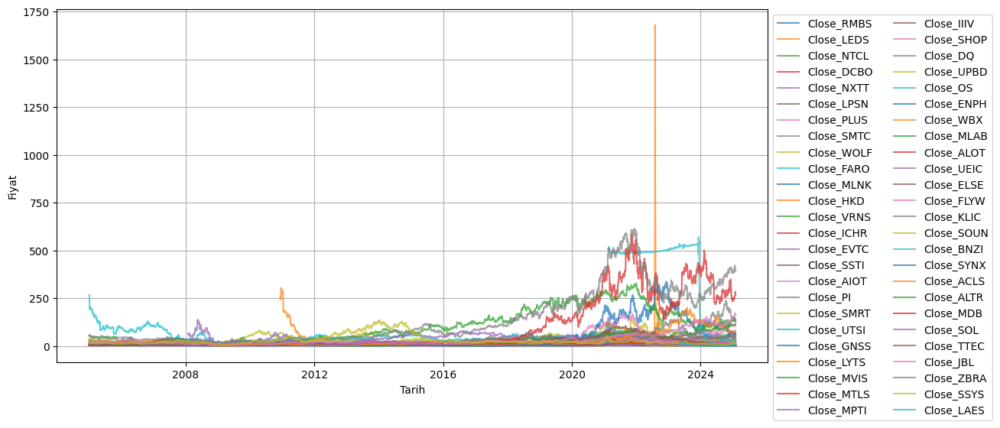

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Veriyi oku
data_close_tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/daily_data/daily_technology.csv')

# 'Date' sütununu datetime formatına çevir
data_close_tech['Date'] = pd.to_datetime(data_close_tech['Date'])

# Şirket isimlerini al (Date sütunu hariç)
company_names = data_close_tech.columns[1:]

# Rastgele şirket seç
selected_companies = np.random.choice(company_names, 50, replace=False)

# Grafik boyutunu belirle
plt.figure(figsize=(12, 6))

# Seçilen şirketleri plot et
for company in selected_companies:
    plt.plot(data_close_tech['Date'], data_close_tech[company], label=company, alpha=0.7)

# Grafik başlık ve etiketleri
plt.xlabel('Tarih')
plt.ylabel('Fiyat')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=2)  # Legend'i dışarı al
plt.grid(True)

# Grafiği göster
plt.show()


- Aynı grafiği aylık değişim verileri üzerinde de gösterelim.

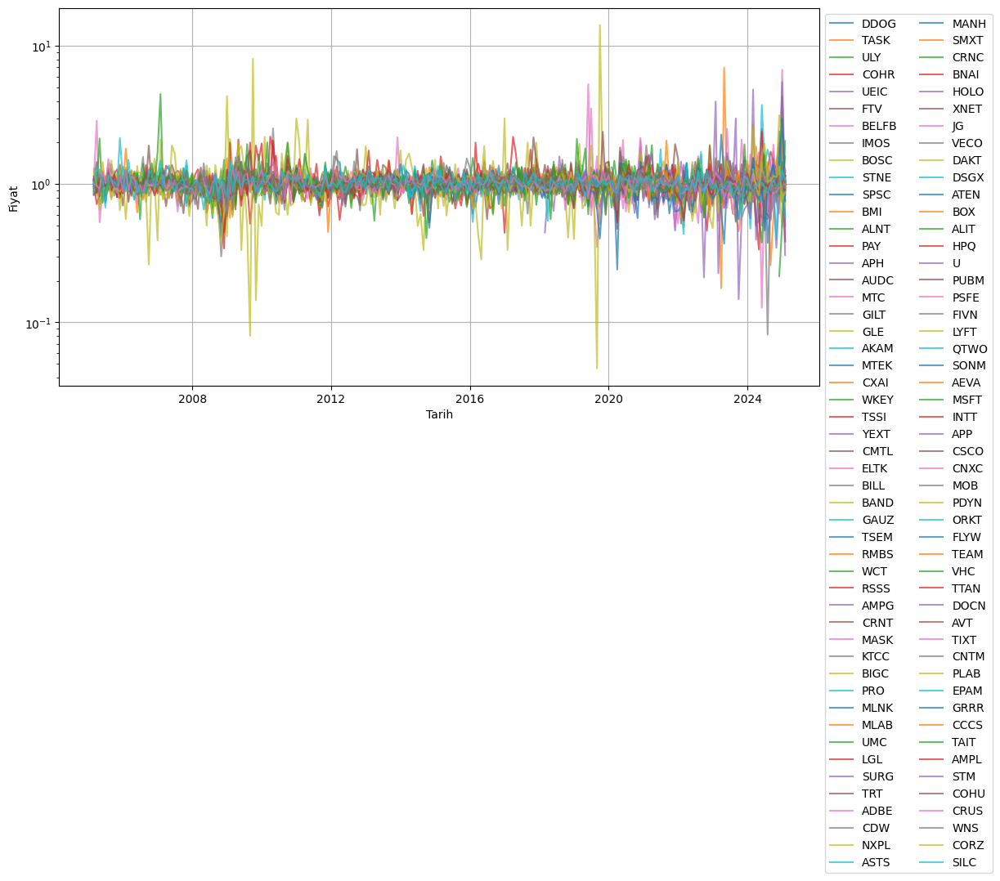

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Veriyi oku
data_close_tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv')

# 'Date' sütununu datetime formatına çevir
data_close_tech['Date'] = pd.to_datetime(data_close_tech['Date'])

# Şirket isimlerini al (Date sütunu hariç)
company_names = data_close_tech.columns[1:]

# Rastgele 100 şirket seç
selected_companies = np.random.choice(company_names, 100, replace=False)

# Grafik boyutunu belirle
plt.figure(figsize=(12, 6))

# Seçilen şirketleri plot et
for company in selected_companies:
    plt.plot(data_close_tech['Date'], data_close_tech[company], label=company, alpha=0.7)

#Büyük farkları daha anlaşılır hale getirmek için logaritmik ölçek kullan.
plt.yscale('log')

# Grafik başlık ve etiketleri
plt.xlabel('Tarih')
plt.ylabel('Fiyat')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=2)  # Legend'i dışarı al
plt.grid(True)

# Grafiği göster
plt.show()


# 3) ydata_profiling KÜTÜPHANESİ İLE VERİLERİN PROFİLLERİNİN ÇIKARILMASI VE TEMİZLENMESİ

- Aylık değişim verilerini çekelim.

In [ ]:
data_finance = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv')
data_healthcare = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv')
data_technology = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv')

In [ ]:
print(data_finance.shape)
print(data_healthcare.shape)
print(data_technology.shape)

(241, 885)
(241, 1163)
(241, 770)


- Gerekli kütüphane kurulumu.

In [ ]:
!pip install ydata_profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 80.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=cc1fcb74247c4b0aabc4a48ad48d71b1b3e791fc78bf897f5e6e648b4e469de6
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


- Profilleri çıkarma ve kaydetme aşaması.

In [ ]:
import numpy as np
import pandas as pd
from ydata_profiling import ProfileReport


df_T = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv')
profile = ProfileReport(df_T, title="Profiling Report", minimal=True)
profile.to_file("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/profiles/technology_p.html")

df_F = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv')
profile = ProfileReport(df_F, title="Profiling Report", minimal=True)
profile.to_file("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/profiles/finance_p.html")

df_H = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv')
profile = ProfileReport(df_H, title="Profiling Report", minimal=True)
profile.to_file("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/profiles/healthcare_p.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

- Bu adımda verilerin profillerini inceleyelim. Verilerdeki boş sütunlar ve yüzdelerine bakarak silinmesi gereken ne kadar hisse olduğuna karar vermek için aşağıdaki kodu uygulayalım.

In [ ]:
import pandas as pd

def clean_dataframe(file_path):
    df = pd.read_csv(file_path)  # CSV dosyasını oku
    initial_columns = df.shape[1]  # Başlangıçtaki sütun sayısını al
    threshold = 0.80 * len(df)  # Eksik veri eşiğini belirle (%80 ve daha fazla boş olan sütunlar çıkarılacak)

    # Eksik verisi eşiği aşan sütunları belirle
    removed_cols = [col for col in df.columns if df[col].isnull().sum() > threshold]

    # Belirlenen sütunları veri setinden çıkar
    df_cleaned = df.drop(columns=removed_cols)

    removed_columns = len(removed_cols)  # Çıkarılan sütun sayısını hesapla

    # Temizleme işlemi hakkında bilgi yazdır
    print(f"{file_path}: {removed_columns} sütun tespit edildi, kalan: {df_cleaned.shape[1]}\n")

    return df_cleaned  # Temizlenmiş veri setini döndür

# Teknoloji, finans ve sağlık sektörlerine ait veri setlerini temizle
tech = clean_dataframe('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv')
fin = clean_dataframe('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv')
heal = clean_dataframe('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv')


/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv: 220 sütun tespit edildi, kalan: 550

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv: 223 sütun tespit edildi, kalan: 662

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv: 359 sütun tespit edildi, kalan: 804



- Verilerin profillerini incelendi. En az 550 civarında hisse senedi ile çalışabilmek için %80'lik bir eşik değer konulması gerekiyor.
- Yapılan araştırmalar bu eşik değerinin %25 olduğu yönünde ancak bu çalışmada oldukça fazla boş değer içeren bir veri ile çalıştığımızdan ve proje kapsamında en az 500 adet hisse senedi beklentisi olduğundan eşik değer %80 olarak belirlenmiştir.
- Bu doğrultuda verilerin her bir sütunu ele alarak sektör başına 550 adet kalana kadar en çok boşluk içeren hisseler veriden silelim.

In [ ]:
import pandas as pd

def reduce_columns(file_path, target_columns=550):
    df = pd.read_csv(file_path)  # CSV dosyasını oku

    missing_counts = df.isnull().sum()  # Her sütundaki eksik veri sayısını hesapla
    sorted_columns = missing_counts.sort_values(ascending=False).index  # Eksik veri sayısına göre sütunları sırala

    # Eğer sütun sayısı hedeflenen sütun sayısından fazlaysa
    if df.shape[1] > target_columns:
        columns_to_drop = sorted_columns[:df.shape[1] - target_columns]  # En çok eksik veriye sahip sütunları belirle
        df_cleaned = df.drop(columns=columns_to_drop)  # Belirlenen sütunları veri setinden çıkar

        # İşlem hakkında bilgi yazdır
        print(f"{file_path}: {len(columns_to_drop)} sütun çıkarıldı, kalan: {df_cleaned.shape[1]}\n")

    else:
        df_cleaned = df  # Eğer sütun sayısı zaten hedefin altındaysa, veri seti değiştirilmez
        print(f"{file_path}: Sütun sayısı zaten {target_columns} veya daha az, değişiklik yapılmadı.")

    return df_cleaned  # Temizlenmiş veri setini döndür

# Teknoloji, finans ve sağlık sektörlerine ait veri setlerini temizle
tech = reduce_columns('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv')
fin = reduce_columns('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv')
heal = reduce_columns('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv')


/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_technology.csv: 220 sütun çıkarıldı, kalan: 550

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_finance.csv: 335 sütun çıkarıldı, kalan: 550

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_healthcare.csv: 613 sütun çıkarıldı, kalan: 550



- Temizlenmiş veriyi kaydedelim.

In [ ]:
tech.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_tech.csv', index=False)
fin.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_fin.csv', index=False)
heal.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_heal.csv', index=False)

In [ ]:
tech.head()

,Date,AAPL,ACN,ADBE,ADI,ADP,ADSK,AMAT,AMD,ANET,...,SOBR,SONM,SYTA,TAOP,UAVS,VERB,VS,VVPR,WATT,XTKG
0,2005-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2005-02-28,1.166710,0.980807,1.085237,1.024811,0.988041,1.011917,1.097484,1.104430,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2005-03-31,0.928889,0.945205,1.087987,0.984205,1.050084,1.001862,0.931232,0.923782,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2005-04-30,0.865370,0.898551,0.885366,0.943829,0.966407,1.069556,0.915077,0.882754,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2005-05-31,1.102608,1.072811,1.113839,1.090030,1.008288,1.243481,1.106291,1.152495,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


- Teknlolji şirketlerinin görselleştirmesi için Seaborn kütüphanesi kullanılarak yatay çubuk grafiği oluşturulmuştur. İlk 70 hisse senedinin eksik veri oranları büyükten küçüğe sıralanarak gösterilmiştir. Alternatif olarak, eksik veri dağılımını görmek için histogram da kullanılmıştır.

- Bu analiz, hangi hisse senetlerinde veri kaybının daha fazla olduğunu belirlemek ve eksik veri temizleme sürecine rehberlik etmek amacıyla yapılmıştır.

<ipython-input-13-27c460cb686b>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=missing_ratios_sorted[:70], y=missing_ratios_sorted.index[:70], palette="viridis")  # İlk 70 hisseyi çiz


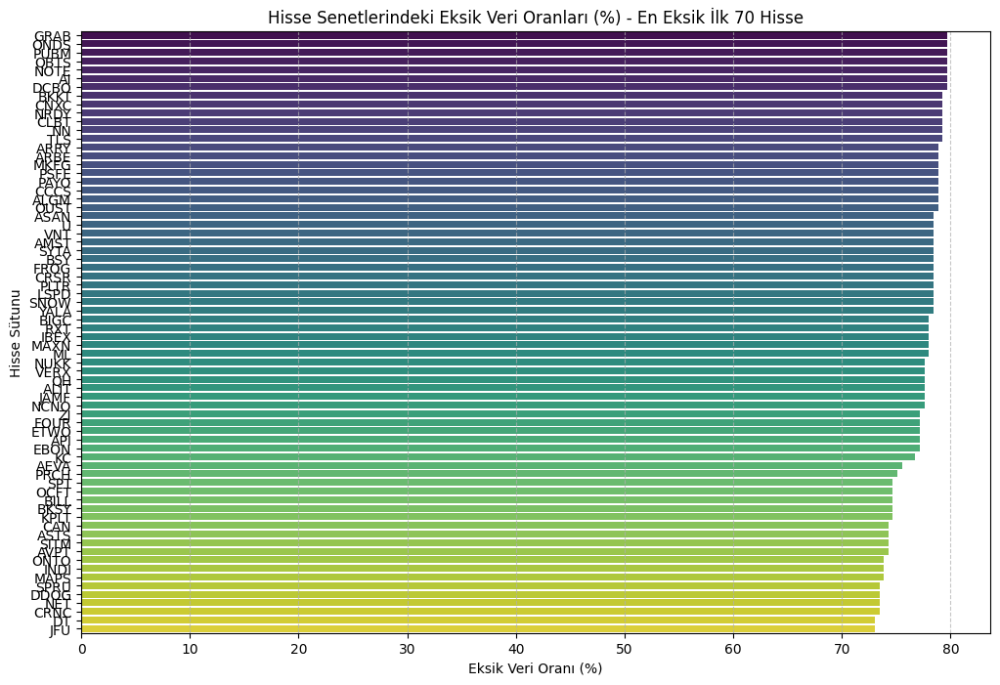

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Eksik veri oranlarını hesapla
missing_ratios = tech.isnull().mean() * 100  # Yüzde cinsinden eksik veri oranı

# Eksik veri oranlarına göre büyükten küçüğe sırala
missing_ratios_sorted = missing_ratios.sort_values(ascending=False)

# Görselleştirme
plt.figure(figsize=(12, 8))
sns.barplot(x=missing_ratios_sorted[:70], y=missing_ratios_sorted.index[:70], palette="viridis")  # İlk 70 hisseyi çiz
plt.xlabel("Eksik Veri Oranı (%)")
plt.ylabel("Hisse Sütunu")
plt.title("Hisse Senetlerindeki Eksik Veri Oranları (%) - En Eksik İlk 70 Hisse")
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.show()


**DISTFIT KÜTÜPHANESİ İLE TECHNOLOGY SEKTÖRÜNE AİT HİSSELERİN DAĞILIMLARININ İNCELENMESİ**

In [ ]:
!pip install distfit

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.9/42.9 kB 1.9 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
from sklearn.model_selection import train_test_split
from distfit import distfit

In [ ]:
tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_tech.csv')
tech = tech.drop(columns=['Date'])
tech.describe()

,AAPL,ACN,ADBE,ADI,ADP,ADSK,AMAT,AMD,ANET,ANSS,...,SOBR,SONM,SYTA,TAOP,UAVS,VERB,VS,VVPR,WATT,XTKG
count,240.000000,240.000000,240.000000,240.000000,240.000000,240.000000,240.000000,240.000000,127.000000,240.000000,...,189.000000,68.000000,52.000000,220.000000,212.000000,122.000000,149.000000,116.000000,130.000000,69.000000
mean,1.026452,1.014700,1.015498,1.012047,1.012536,1.015682,1.015756,1.022043,1.033267,1.015944,...,1.072198,0.959526,0.857898,1.007755,0.996275,1.004605,1.009066,1.031332,0.985791,1.147011
std,0.089612,0.062818,0.089439,0.073461,0.053976,0.107520,0.093532,0.168241,0.113149,0.078433,...,0.589237,0.299748,0.296016,0.366651,0.406051,0.432260,0.324772,0.555392,0.305692,1.855830
min,0.670442,0.855136,0.674943,0.800562,0.817544,0.635171,0.746022,0.589511,0.771197,0.756007,...,0.155714,0.241379,0.230496,0.400000,0.230769,0.037500,0.239163,0.469283,0.404858,0.300000
25%,0.968751,0.974320,0.957819,0.960056,0.979926,0.944247,0.950994,0.918138,0.955560,0.963190,...,0.800000,0.811470,0.710156,0.860376,0.814599,0.743019,0.848951,0.819887,0.822490,0.744681
50%,1.030927,1.021605,1.024993,1.014606,1.012624,1.016589,1.013841,0.998214,1.044822,1.018189,...,1.000000,0.924880,0.842014,0.973816,0.927922,0.923077,1.000000,0.952386,0.936496,0.893334
75%,1.087794,1.053400,1.066058,1.056384,1.046474,1.089850,1.077160,1.128238,1.096502,1.068975,...,1.178947,1.124825,1.062182,1.091267,1.057975,1.110000,1.057286,1.031316,1.060813,1.080357
max,1.237701,1.160929,1.280838,1.222532,1.174821,1.324665,1.396669,1.523913,1.328103,1.272273,...,5.769231,2.285068,1.607463,5.346535,3.536585,3.186813,2.700000,5.271676,3.001346,16.057692


Streaming output truncated to the last 5000 lines.
[distfit] >INFO> [uniform   ] [0.09 sec] [RSS: 31.0127] [loc=0.730 scale=0.689]
[distfit] >INFO> [loggamma  ] [0.09 sec] [RSS: 3.87504] [loc=-30.942 scale=4.438]
[distfit] >INFO> Compute confidence intervals [parametric]
[distfit] >INFO> Create pdf plot for the parametric method.
[distfit] >INFO> Estimated distribution: T(loc:1.006100, scale:0.092431)
[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 4.06221] [loc=1.013 scale=0.126]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 49.2422] [loc=0.631 scale=0.383]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 49.2422] [loc=-33554431.369 scale=33554432.000]
[distfit] >INFO> [dweibull  ] [0.02 sec] [RSS: 1.22471] [loc=1.008 scale=0.093]
[distfit] >INFO> [t         ] [0.13 sec] [RSS: 0.98842] [loc=1.006 scale=0.086]
[distfit] >INFO> [genextreme] [0.09 sec] [RSS: 4.56447] [loc=0.962 scale=0.116]
[distfit] >INFO> [gamma     ] [0.05 sec] [RSS: 3.436

  Distribution  Percentage
0     dweibull   34.426230
1     loggamma    2.914390
2            t   44.444444
3      lognorm    5.646630
4         norm    1.092896
5         beta    3.460838
6        gamma    2.003643
7   genextreme    6.010929


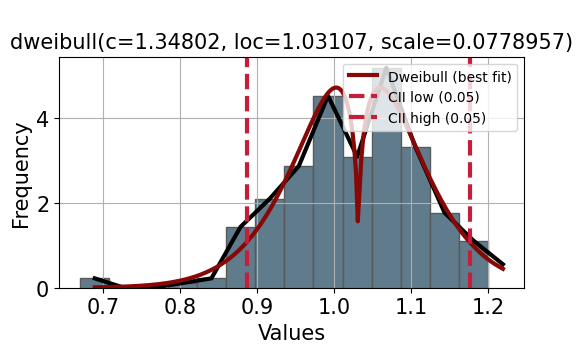

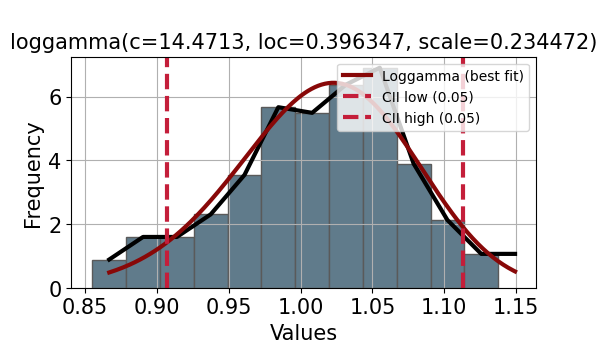

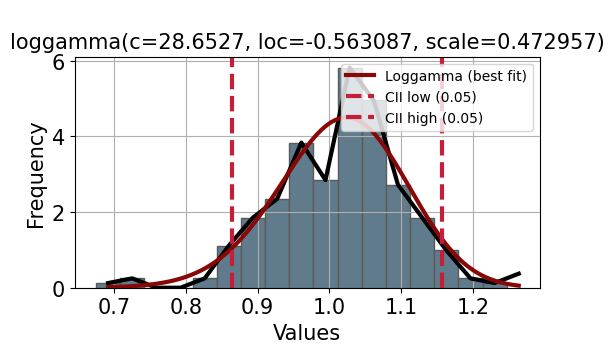

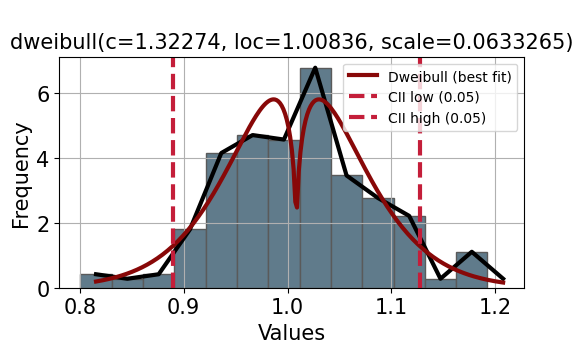

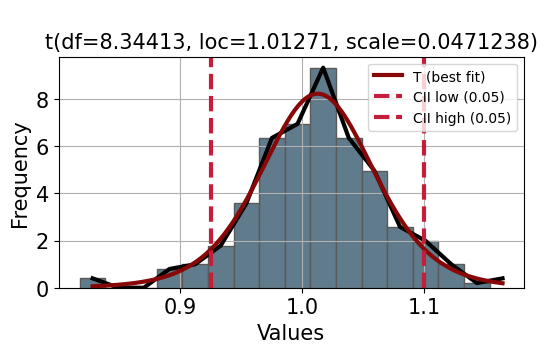

...

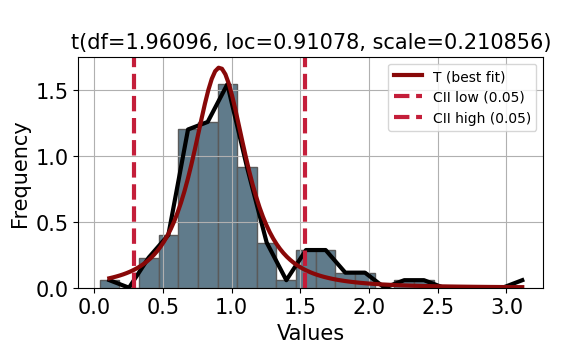

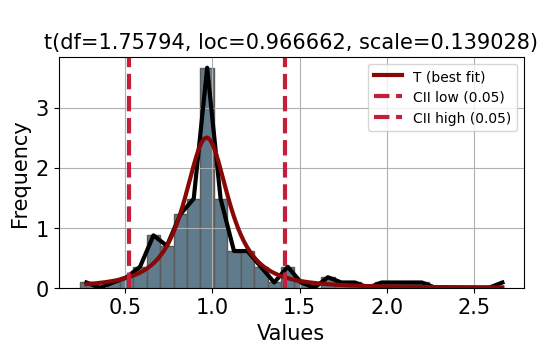

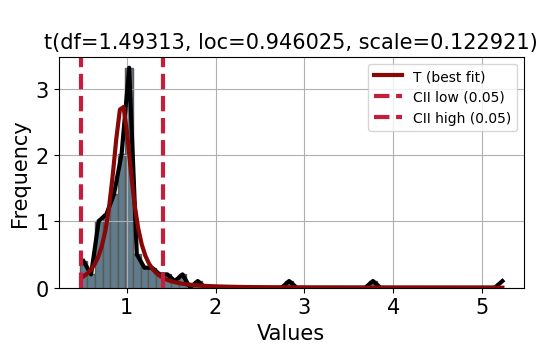

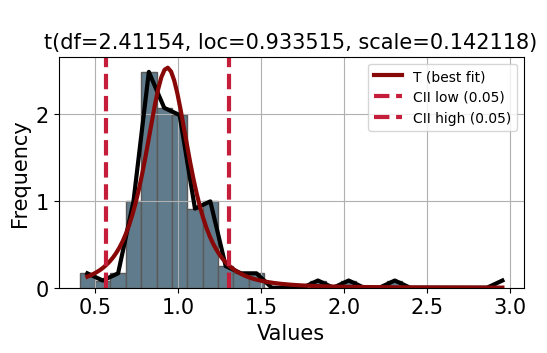

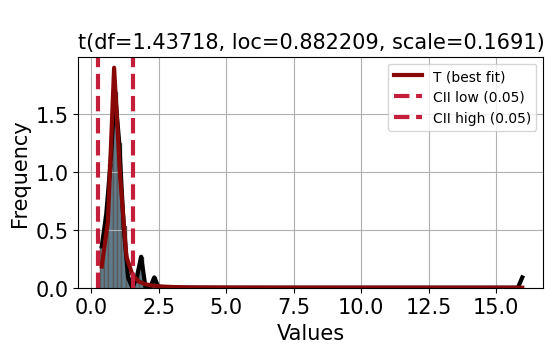

In [ ]:
import numpy as np
import pandas as pd
from collections import Counter
from distfit import distfit

def dist_check(df, tickers):
    distribution_results = []

    for ticker in tickers:
        dfit = distfit()

        # Sütunun olup olmadığını kontrol et
        if ticker not in df.columns:
            print(f"Uyarı: '{ticker}' sütunu DataFrame içinde bulunamadı, atlanıyor.")
            continue

        # NaN ve sonsuz değerleri temizle
        clean_data = df[ticker].replace([np.inf, -np.inf], np.nan).dropna().to_numpy()

        if len(clean_data) == 0:
            print(f"Uyarı: '{ticker}' sütununda geçerli veri yok, atlanıyor.")
            continue

        # Dağılımı belirle
        results = dfit.fit_transform(clean_data)
        dfit.plot(fontsize=15, figsize=(6, 3))

        # En iyi uyum sağlayan dağılımı sakla
        best_fit = results['summary']['name'][0]
        distribution_results.append(best_fit)

    # Dağılımları yüzdesel olarak hesapla
    dist_counts = Counter(distribution_results)
    total = sum(dist_counts.values())
    dist_percentages = {dist: (count / total) * 100 for dist, count in dist_counts.items()}

    return pd.DataFrame(list(dist_percentages.items()), columns=['Distribution', 'Percentage'])

# Veri dosyasını oku
tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_tech.csv')

# 'Date' sütununu hariç tutarak diğer sütun isimlerini al
tickers = tech.drop(columns=['Date']).columns

# Fonksiyonu çalıştır
distribution_results_df = dist_check(tech, tickers)

# Sonuçları göster
print(distribution_results_df)


In [ ]:
distribution_results_df

,Distribution,Percentage
0,dweibull,34.426230
1,loggamma,2.914390
2,t,44.444444
3,lognorm,5.646630
4,norm,1.092896
5,beta,3.460838
6,gamma,2.003643
7,genextreme,6.010929


- Yukarıda technology sektöründeki hisselerin dağılımlarının çoğunlukla 't' ve 'dweibull' dağılımlarına yakın olduğu görülmektedir.
- Bu dağılımlar doğrultusunda veriye manuel olarak herhangi bir transformasyon işlemi uygulanmayacaktır çünkü tsfresh kütüphanesi ile otomatik olarak Feature Extraction ve Transformation işlemleri uygulanacaktır.

# 4) VERİNİN UYGUN FORMATA GETİRİLMESİ

- Bu adımda 3 sektöre ait veriler birleştirilmiş ve tsfresh'e uygun dikey formata getirilmiştir.

- Her sektörün birbirinden ayrı verilerini 'Date' sütunu eşleşecek şekilde sütunlar bazında birleştirelim.

In [ ]:
# Verisetlerini Date sütunu üzerinden birleştirme
data_merged = tech.merge(fin, on='Date', how='outer').merge(heal, on='Date', how='outer')
print(data_merged)

           Date      AAPL       ACN      ADBE       ADI       ADP      ADSK  \
0    2005-01-31       NaN       NaN       NaN       NaN       NaN       NaN   
1    2005-02-28  1.166710  0.980807  1.085237  1.024811  0.988041  1.011917   
2    2005-03-31  0.928889  0.945205  1.087987  0.984205  1.050084  1.001862   
3    2005-04-30  0.865370  0.898551  0.885366  0.943829  0.966407  1.069556   
4    2005-05-31  1.102608  1.072811  1.113839  1.090030  1.008288  1.243481   
..          ...       ...       ...       ...       ...       ...       ...   
236  2024-09-30  1.017467  1.033718  0.901412  0.983969  1.008041  1.066099   
237  2024-10-31  0.969571  0.979471  0.923326  0.969327  1.045206  1.030202   
238  2024-11-30  1.051707  1.050896  1.079171  0.977321  1.061160  1.028541   
239  2024-12-31  1.055155  0.970803  0.861900  0.978489  0.958677  1.012573   
240  2025-01-31  0.942417  1.094261  0.983741  0.997317  1.035118  1.053354   

         AMAT       AMD      ANET  ...      QLGN   

- Veriyi tsfresh kütüphanesine uygun formata getirelim. Daha önce eklenmemiş olan 'Sector' sütununu da veriye ekleyelim ve istenen formattaki veriyi kaydedelim.

In [ ]:
import pandas as pd

# Dosyaları oku
tech = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_tech.csv')
fin = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_fin.csv')
heal = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_heal.csv')

# Her dosyaya sector sütunu ekleyelim
tech['Sector'] = 'T'
fin['Sector'] = 'F'
heal['Sector'] = 'H'

# Her dosyayı uygun formatta dönüştürme
def combine(df):
    # 'Date' ve hisse sütunlarını 'Date', 'Ticker' ve 'Close' formatına getirme
    data_ready = pd.melt(df, id_vars=['Date', 'Sector'], var_name='Ticker', value_name='Close')
    return data_ready

# Her bir dosyayı dönüştür
technology_combined = combine(tech)
finance_combined = combine(fin)
healthcare_combined = combine(heal)

# Tüm dosyaları birleştir
concat_df = pd.concat([technology_combined, finance_combined, healthcare_combined], ignore_index=True)

concat_df.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/concat_data.csv', index=False)

In [ ]:
concat_df

,Date,Sector,Ticker,Close
0,2005-01-31,T,AAPL,NaN
1,2005-02-28,T,AAPL,1.166710
2,2005-03-31,T,AAPL,0.928889
3,2005-04-30,T,AAPL,0.865370
4,2005-05-31,T,AAPL,1.102608
...,...,...,...,...
396922,2024-09-30,H,XYLO,0.953623
396923,2024-10-31,H,XYLO,1.024316
396924,2024-11-30,H,XYLO,1.163205
396925,2024-12-31,H,XYLO,0.923469


# 5) VERİYE GEREKLİ ENCODING İŞLEMLERİNİN YAPILMASI

- 'Date' sütununa Ordinal Encoding, 'Symbol' ve 'Sector' sütunlarına ise Label Encoding uygulaması yapalım.

In [ ]:
import pandas as pd
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder

def encode_data(file_path, output_path):
    # CSV dosyasını oku
    df = pd.read_csv(file_path)

    # Tarih sütununu Ordinal Encoding ile dönüştür
    encoder_date = OrdinalEncoder()
    df.iloc[:, 0] = encoder_date.fit_transform(df.iloc[:, [0]])
    print(f"{file_path}: Tarih sütunu sayısal değerlere dönüştürüldü.")

    # Symbol sütunu varsa, Label Encoding ile kodla
    if "Ticker" in df.columns:
        encoder_Ticker = LabelEncoder()
        df["Ticker_encoded"] = encoder_Ticker.fit_transform(df["Ticker"])  # Yeni sütun oluştur
        df.drop(columns=["Ticker"], inplace=True)  # Orijinal sütunu kaldır
        print(f"{file_path}: 'Ticker' sütunu sayısal forma çevrildi ve eski hali kaldırıldı.")

    # Sector sütunu varsa, Label Encoding ile kodla
    if "Sector" in df.columns:
        encoder_Sector = LabelEncoder()
        df["Sector"] = encoder_Sector.fit_transform(df["Sector"])  # Kategorik değerleri sayısala çevir
        print(f"{file_path}: 'Sector' sütunu sayısal formata dönüştürüldü.")

    # İşlenmiş veriyi yeni CSV dosyası olarak kaydet
    df.to_csv(output_path, index=False)
    print(f"Veri başarıyla kodlandı ve kaydedildi: {output_path}")

# Veriyi dönüştür ve kaydet
encode_data('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/concat_data.csv',
            '/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/encoded_data.csv')


/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/concat_data.csv: Tarih sütunu sayısal değerlere dönüştürüldü.
/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/concat_data.csv: 'Ticker' sütunu sayısal forma çevrildi ve eski hali kaldırıldı.
/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/concat_data.csv: 'Sector' sütunu sayısal formata dönüştürüldü.
Veri başarıyla kodlandı ve kaydedildi: /content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/encoded_data.csv


# 6) VERİYE IMPUTING İŞLEMİ UYGULANMASI

- Verimizde bulunan 'Price' sütunundaki boş değerler için IterativeImputer ile doldurma yapalım. Ancak veri şu anda tsfresh formatında olduğundan tüm hisselerin fiyat değişim oranı değerleri aynı sütunda bulunmaktadır. Imputing aşamasında veri alındıktan sonra her 'Symbol' değeri için gruplama yapılarak boş değerleri dolduralım. Aksi taktirde tüm değerler ele alınarak doldurma işlemi yapılmış olur ve bu da mantıksız bir doldurma işlemi olur.

- Imputing aşamasında 3 farklı ML modeli de deneyelim ve en iyisine karar verelim.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge
from sklearn.model_selection import train_test_split
from sklearn.impute import IterativeImputer
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor

df = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/encoded_data.csv")

# Farklı modellerle imputing yapma fonksiyonu
def impute_Close_by_Ticker(df, model):
    imputer = IterativeImputer(estimator=model, initial_strategy='mean', random_state=0)

    # Her Ticker_encoded için ayrı ayrı işlem yap
    df_imputed = df.copy()
    for Ticker in df['Ticker_encoded'].unique():
        mask = df['Ticker_encoded'] == Ticker
        df_subset = df.loc[mask, ['Close']]

        # Imputer'ı fit ve transform et
        df_imputed.loc[mask, 'Close'] = imputer.fit_transform(df_subset)

    return df_imputed

# Farklı modellerle imputing işlemi
models = {
    'DecisionTreeRegressor': DecisionTreeRegressor(max_depth=10, min_samples_split=5, min_samples_leaf=2, random_state=0),
    'ExtraTreesRegressor': ExtraTreesRegressor(n_estimators=100, max_depth=10, min_samples_split=5, min_samples_leaf=2, random_state=0),
    'KNeighborsRegressor': KNeighborsRegressor(n_neighbors=5, weights='distance', metric='minkowski', p=2)
}

# Sonuçları saklamak için bir dict
imputed_results = {}

for model_name, model in models.items():
    print(f"Imputing using {model_name}...")
    df_imputed = impute_Close_by_Ticker(df, model)
    imputed_results[model_name] = df_imputed

Imputing using DecisionTreeRegressor...
Imputing using ExtraTreesRegressor...
Imputing using KNeighborsRegressor...


In [ ]:
# Örneğin DecisionTreeRegressor sonucu:
print("ExtraTreesRegressor ile imputing sonrası:")
print(imputed_results['ExtraTreesRegressor'])

ExtraTreesRegressor ile imputing sonrası:
         Date  Sector     Close  Ticker_encoded
0         0.0       2  1.026452               4
1         1.0       2  1.166710               4
2         2.0       2  0.928889               4
3         3.0       2  0.865370               4
4         4.0       2  1.102608               4
...       ...     ...       ...             ...
396922  236.0       1  0.953623            1631
396923  237.0       1  1.024316            1631
396924  238.0       1  1.163205            1631
396925  239.0       1  0.923469            1631
396926  240.0       1  1.207182            1631

[396927 rows x 4 columns]


- Imputing için denediğimiz farklı modellerin KDE diyagramını örnek bir hissenin kapanış değeri için çizdirelim.

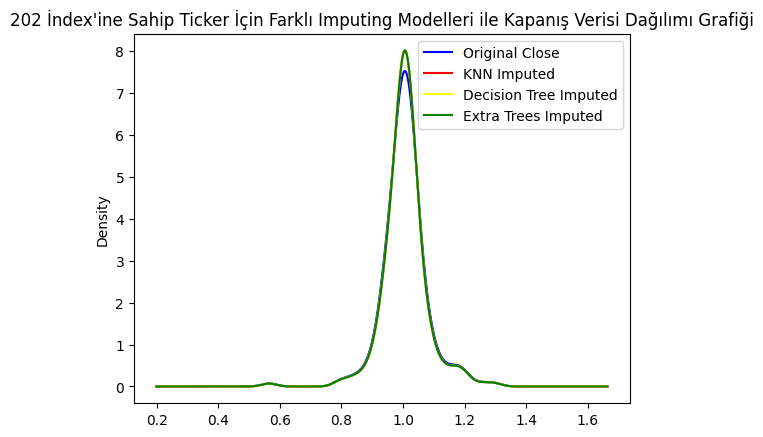

In [ ]:
import matplotlib.pyplot as plt
# KDE grafiği için görselleştirme
fig = plt.figure()
ax = fig.add_subplot(111)

Ticker_value = 202
# Seçilen Ticker_encoded için her modelin imputing dağılımını KDE ile çiziyoruz
df_subset = df[df['Ticker_encoded'] == Ticker_value]  # Seçilen Ticker için veri alt kümesi

# Orijinal veriyi çiz
df_subset['Close'].plot(kind='kde', ax=ax, color='blue', label='Original Close')

# Her modelin imputing sonuçlarını çiz
imputed_results['KNeighborsRegressor'][df_imputed['Ticker_encoded'] == Ticker_value]['Close'].plot(kind='kde', ax=ax, color='red', label='KNN Imputed')
imputed_results['DecisionTreeRegressor'][df_imputed['Ticker_encoded'] == Ticker_value]['Close'].plot(kind='kde', ax=ax, color='yellow', label='Decision Tree Imputed')
imputed_results['ExtraTreesRegressor'][df_imputed['Ticker_encoded'] == Ticker_value]['Close'].plot(kind='kde', ax=ax, color='green', label='Extra Trees Imputed')

# Efsane (legend) ekleyelim
ax.legend(loc='best')

# Grafik başlığı ve gösterim
plt.title(f"{Ticker_value} İndex'ine Sahip Ticker İçin Farklı Imputing Modelleri ile Kapanış Verisi Dağılımı Grafiği")
plt.show()

- KDE diyagramı incelenerek 3 modelin de oldukça benzer bir doldurma işlemi yaptığı görülmüştür. Modellerden 'ExtraTreesRegressor' modelini seçelim ve veriye Imputing işlemi uyguladıktan sonra kaydedelim.

In [ ]:
imputed_data = impute_Close_by_Ticker(df, models["ExtraTreesRegressor"])

In [ ]:
imputed_data.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/imputed_data.csv', index=False)

In [ ]:
imputed_data.head()

,Date,Sector,Close,Ticker_encoded
0,0.0,2,1.026452,4
1,1.0,2,1.166710,4
2,2.0,2,0.928889,4
3,3.0,2,0.865370,4
4,4.0,2,1.102608,4


# 7) SCALING UYGULAMASI

- Borsa verilerinde hangi ölçekleme yönteminin kullanılacağı, verinin doğasına bağlıdır. Hisse senedi fiyatları farklı büyüklüklerde olduğu için, belirli bir aralığa çekilerek ölçeklendirilmesi gereken durumlarda normalizasyon tercih edilmelidir. Ancak, hisse senedi getirileri gibi ortalama etrafında dalgalanan veriler analiz ediliyorsa, değişkenlerin standart sapma ile normalize edilmesi gerektiğinden standardizasyon daha uygundur. Veri setimiz hali hazırda aylık ortalama değişimlerden oluştuğundan değer aralığı (max ve min farkı) fazla değildir. Bu nedenle 'Price' sütunu üzerinde 'StandartScaler' uygulaması yapalım.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler


# Farklı Ticker_encoded değerlerine göre ayrı ayrı StandardScaler uygulama fonksiyonu
def scale_by_Ticker(df):
    scaler = StandardScaler()

    df_scaled = df.copy()  # Orijinal veri kaybolmasın diye bir kopya alıyoruz.

    # Her Ticker_encoded için işlem yap
    for Ticker in df['Ticker_encoded'].unique():
        # İlgili Ticker_encoded değerine göre veri alt kümesi seç
        mask = df['Ticker_encoded'] == Ticker
        df_subset = df.loc[mask, ['Close']]

        # StandardScaler'ı fit et ve dönüştür
        df_scaled.loc[mask, 'Close'] = scaler.fit_transform(df_subset[['Close']])

    return df_scaled

imputed_data = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/imputed_data.csv')

# StandardScaler uygulama
scaled_data = scale_by_Ticker(imputed_data)

# Sonuçları göster
print(scaled_data)

         Date  Sector     Close  Ticker_encoded
0         0.0       2  0.000000               4
1         1.0       2  1.571702               4
2         2.0       2 -1.093263               4
3         3.0       2 -1.805040               4
4         4.0       2  0.853384               4
...       ...     ...       ...             ...
396922  236.0       1 -0.046737            1631
396923  237.0       1  0.396067            1631
396924  238.0       1  1.266035            1631
396925  239.0       1 -0.235614            1631
396926  240.0       1  1.541500            1631

[396927 rows x 4 columns]


- Scale edilmiş veriyi kaydedelim.

In [ ]:
scaled_data.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv', index=False)

# 8) TSFRESH KÜTÜPHANESİ İLE FEATURE EXTRACTION UYGULAMASI

- Tsfresh kütüphanesini indirelim.

In [ ]:
!pip install tsfresh==0.20.0

INFO: pip is looking at multiple versions of distributed to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of dask-expr to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 18.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.5/176.5 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.2/243.2 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 4.1 MB/s eta 0:00:00


- Gerekli importları yapalım.

In [ ]:
import pandas as pd
from tsfresh import extract_features
from tsfresh.utilities.dataframe_functions import impute
from tsfresh.feature_extraction.settings import EfficientFCParameters, MinimalFCParameters

- Tsfresh'e uygun formata getirdiğimiz verimizden feature'lar çıkarmak ve transformasyon uygulamak için 'extract_feature' fonksiyonunu kullanalım. 'impute' ile de özniteliklerdeki boş değerleri dolduralım.


**NOT : Colab üzerinde Tsfresh kütüphanesi ile sürekli olarak uyumsuzluk hatası aldım. Bu nedenle projenin sadece bu aşamasını localde JupyterLab üzerinden yürüttüm. Aşağıdaki feature extraction kodlarının outputları bu nedenle bulunmamaktadır ancak feature verileri localden tekrar Colab data/features klasörüne eklenmiştir.**

In [ ]:
from tsfresh.feature_extraction import extract_features, EfficientFCParameters  # TSFresh kütüphanesinden özellik çıkarma fonksiyonlarını içe aktar

df = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv')  # Veriyi CSV dosyasından oku

# Özellikleri çıkar (TSFresh kullanarak)
features = extract_features(df,
                            column_id="Ticker_encoded",  # Hisse sembollerini belirten sütun
                            column_sort="Date",  # Verilerin zaman sırasına göre düzenlenmesini sağlayan sütun
                            column_value="Close",  # Özellik çıkarımının uygulanacağı fiyat verisi sütunu
                            default_fc_parameters=EfficientFCParameters())  # Verimli özellik çıkarma parametrelerini kullan

features = impute(features)  # Eksik değerleri doldur
print(features.head())  # İlk birkaç satırı ekrana yazdır


- Çıkarılan özniteliklerin kaydedilmesi.

In [ ]:
features.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/features.csv', index=False)

- Özniteliklerin içinde tamamen boş değerlerden oluşan sütunları temizleyelim.

In [ ]:
import pandas as pd

# CSV dosyasını yükle
df = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/features.csv')

# Sadece tamamen boş olan sütunları bul
missing_columns = df.columns[df.isna().all()]

# Her bir boş sütunun adını ve içindeki boş değer sayısını yazdır
for column in missing_columns:
    print(f"Sütun: {column}, Boş Değer Sayısı: {df[column].isna().sum()}")

# Boş sütunları kaldır
df_cleaned = df.dropna(axis=1, how='all')

# Temizlenmiş veri çerçevesini aynı dosyaya kaydet
df_cleaned.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/cleaned_features.csv', index=False)


# 9) FEATURE SELECTION UYGULAMASI

- Tsfresh ile elde edilen özniteliklerin seçimi için RFE ve Lasso yöntemlerini kullanalım. Daha sonra modellerin kurgulanması aşamasında iki yöntem ile seçilen özellikleri kullanarak bir karşılaştırma yapılacaktır.

In [ ]:
import pandas as pd

# Ölçeklendirilmiş veriyi oku
target_dataframe = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv')

# "Ticker_encoded" bazında gruplama yaparak her sembol için ilk "sector" değerini al
target_data = target_dataframe.groupby("Ticker_encoded")["Sector"].first().reset_index()

# Temizlenmiş özellikler veri setini oku
features = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/cleaned_features.csv')


In [ ]:
# Gerekli kütüphaneleri içe aktar
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE

# Özellikleri ve hedef değişkeni tanımla
X = features
y = target_data["Sector"]

# Veri setini eğitim ve test olarak ayır
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

# Recursive Feature Elimination (RFE) yöntemi
randomForest_RFE_selector = RFE(RandomForestClassifier(random_state=20))
randomForest_RFE_selector.fit(X_train, y_train)

# Seçilen özellikleri al
randomForest_RFE_features = X_train.columns[randomForest_RFE_selector.get_support()]
print(f"RFE Selected Features ({len(randomForest_RFE_features)}): {list(randomForest_RFE_features)}")

RFE Selected Features (389): ['Close__mean_abs_change', 'Close__mean_second_derivative_central', 'Close__variation_coefficient', 'Close__skewness', 'Close__kurtosis', 'Close__absolute_sum_of_changes', 'Close__percentage_of_reoccurring_values_to_all_values', 'Close__percentage_of_reoccurring_datapoints_to_all_datapoints', 'Close__ratio_value_number_to_time_series_length', 'Close__maximum', 'Close__absolute_maximum', 'Close__minimum', 'Close__time_reversal_asymmetry_statistic__lag_1', 'Close__c3__lag_2', 'Close__cid_ce__normalize_True', 'Close__quantile__q_0.1', 'Close__quantile__q_0.2', 'Close__quantile__q_0.3', 'Close__quantile__q_0.4', 'Close__quantile__q_0.6', 'Close__quantile__q_0.7', 'Close__quantile__q_0.8', 'Close__quantile__q_0.9', 'Close__autocorrelation__lag_3', 'Close__partial_autocorrelation__lag_3', 'Close__number_cwt_peaks__n_1', 'Close__number_peaks__n_1', 'Close__binned_entropy__max_bins_10', 'Close__index_mass_quantile__q_0.1', 'Close__index_mass_quantile__q_0.2', 'Clos

- RFE yöntemi ile seçilen öznitelikleri kaydedelim.

In [ ]:
randomForest_rfe_selected = features[randomForest_RFE_features]
randomForest_rfe_selected.to_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/rfe_selected_data.csv")

- Logistik Regression ile öznitelik seçimi.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

# Özellikleri ve hedef değişkeni tanımla
X = features
y = target_data["Sector"]

# Veri setini eğitim ve test olarak ayır
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

# L1 Regularization (Lasso) yöntemi
lasso = LogisticRegression(penalty="l1", solver="liblinear", random_state=10)
lasso.fit(X_train, y_train)

# Sıfır olmayan katsayıya sahip özellikleri seç
lasso_selected = X_train.columns[lasso.coef_[0] != 0]
print(f"Lasso Selected Features ({len(lasso_selected)}): {list(lasso_selected)}")

Lasso Selected Features (261): ['Unnamed: 0', 'Close__kurtosis', 'Close__absolute_sum_of_changes', 'Close__longest_strike_below_mean', 'Close__longest_strike_above_mean', 'Close__count_below_mean', 'Close__fft_coefficient__attr_"real"__coeff_1', 'Close__fft_coefficient__attr_"real"__coeff_2', 'Close__fft_coefficient__attr_"real"__coeff_5', 'Close__fft_coefficient__attr_"real"__coeff_6', 'Close__fft_coefficient__attr_"real"__coeff_8', 'Close__fft_coefficient__attr_"real"__coeff_9', 'Close__fft_coefficient__attr_"real"__coeff_11', 'Close__fft_coefficient__attr_"real"__coeff_15', 'Close__fft_coefficient__attr_"real"__coeff_16', 'Close__fft_coefficient__attr_"real"__coeff_20', 'Close__fft_coefficient__attr_"real"__coeff_21', 'Close__fft_coefficient__attr_"real"__coeff_22', 'Close__fft_coefficient__attr_"real"__coeff_24', 'Close__fft_coefficient__attr_"real"__coeff_27', 'Close__fft_coefficient__attr_"real"__coeff_28', 'Close__fft_coefficient__attr_"real"__coeff_30', 'Close__fft_coefficient_

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


- Lasso yöntemi ile seçilen öznitelikleri kaydedelim.

In [ ]:
selected_data = features[lasso_selected]
selected_data.to_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/lasso_selected_data.csv")

# 10) MODELLERİN GELİŞTİRİLMESİ

- RFE ve Lasso yöntemleri ile elde seçilen özniteliklerin eğitimde kullanılacağı modelleri kurgulayalım. Aynı makine öğrenmesi modellerini farklı selection yöntemleri seçilen nitelikler ile eğitelim ve sonuçları karşılaştıralım.

- Modellere verilecek X değeri RFE veya Lasso ile seçilen özniteliklerden oluşmaktadır. Y değeri ise özniteliklerin çıkarıldığı borsa verisindeki her hisse için yer alan sector bilgisidir. Yani Tsfresh kütüphanesine hazır hale getirilen veriden her hisse için gruplama yapılarak sektör değerleri alınmıştır.

**10.1) LASSO SELECTOR İLE SEÇİLEN NİTELİKLER VE MODELLERİ**

- Gerekli kütüphaneleri import edelim.
- Lasso ile seçilen öznitelikleri dosyadan okuyup X değerine eşitleyelim.
- Tsfresh formatındaki veriden hisselere göre gruplama yapalım ve gruplanmış veriden 'sector' sütununu y verisi olarak belirleyelim.
- X ve y verisini %20 test %80 train olacak şekilde bölelim.

In [ ]:
!pip install xgboost==2.1.4, catboost==1.2.7

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 8.6 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, f1_score
import joblib


x_data = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/lasso_selected_data.csv")

data = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv')
gruplanmıs_veri = data.groupby("Ticker_encoded")["Sector"].first().reset_index()  # Symbol sütununa göre gruplama

# Özellikler (X) ve hedef değişken (y) olarak ayırma
X = x_data
y = gruplanmıs_veri['Sector']

# Eğitim ve test verilerine ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



Model: KNeighborsClassifier
Doğruluk Skoru: 0.5606
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.5000    0.9057    0.6443       106
           1     0.6825    0.4095    0.5119       105
           2     0.6133    0.3866    0.4742       119

    accuracy                         0.5606       330
   macro avg     0.5986    0.5672    0.5435       330
weighted avg     0.5989    0.5606    0.5408       330


Model: GradientBoostingClassifier
Doğruluk Skoru: 0.8030
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.8879    0.8962    0.8920       106
           1     0.7257    0.7810    0.7523       105
           2     0.8000    0.7395    0.7686       119

    accuracy                         0.8030       330
   macro avg     0.8045    0.8056    0.8043       330
weighted avg     0.8046    0.8030    0.8030       330


Model: RandomForestClassifier
Doğruluk Skoru: 0.8030
Sınıflandırma Raporu:
        

/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Doğruluk Skoru: 0.5545
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.7177    0.8396    0.7739       106
           1     0.4264    0.5238    0.4701       105
           2     0.5065    0.3277    0.3980       119

    accuracy                         0.5545       330
   macro avg     0.5502    0.5637    0.5473       330
weighted avg     0.5489    0.5545    0.5417       330


Model: DecisionTreeClassifier
Doğruluk Skoru: 0.5606
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.5690    0.6226    0.5946       106
           1     0.4839    0.5714    0.5240       105
           2     0.6556    0.4958    0.5646       119

    accuracy                         0.5606       330
   macro avg     0.5695    0.5633    0.5611       330
weighted avg     0.5731    0.5606    0.5613       330


Model: CatBoostClassifier
Doğruluk Skoru: 0.8061
Sınıflandırma Raporu:
              precision    recall  f1-score  

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [20:24:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Doğruluk Skoru: 0.8182
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.8611    0.8774    0.8692       106
           1     0.7768    0.8286    0.8018       105
           2     0.8182    0.7563    0.7860       119

    accuracy                         0.8182       330
   macro avg     0.8187    0.8207    0.8190       330
weighted avg     0.8188    0.8182    0.8178       330



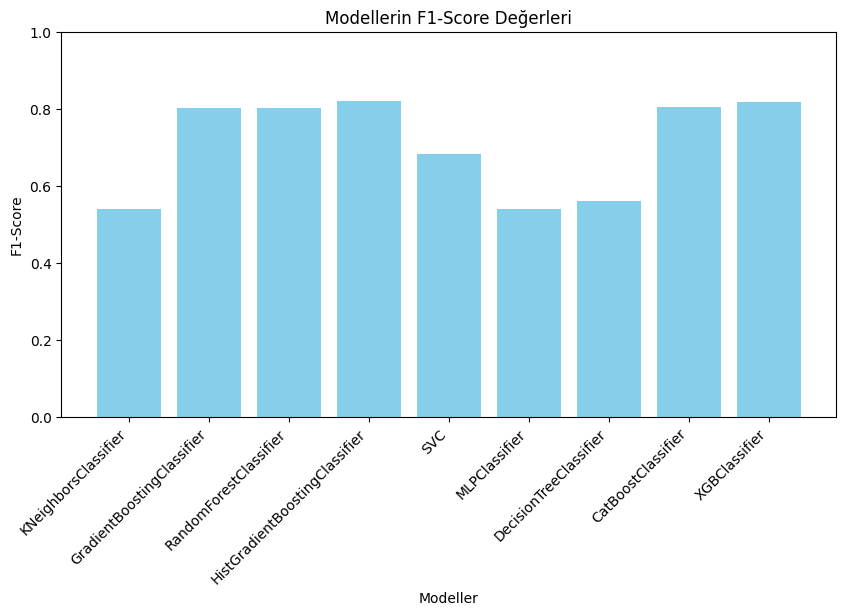

En iyi model: HistGradientBoostingClassifier
En iyi model (HistGradientBoostingClassifier) /content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_lasso_model_HistGradientBoostingClassifier.pkl dizinine kaydedildi.


'\nBu çalışmada, çeşitli makine öğrenmesi modelleri belirlenmiş ve değerlendirilmiştir.\nModeller, eğitim verisi kullanılarak fit edilmiş ve test verisi üzerinde tahminleme yapılmıştır.\nPerformans ölçümleri doğruluk ve F1-score hesaplanarak değerlendirilmiştir.\nElde edilen F1-score değerleri grafik üzerinde görselleştirilmiştir.\nEn iyi performansı gösteren model belirlenerek belirtilen dizine kaydedilmiştir.\nBöylece en iyi modelin daha sonra tekrar kullanılabilmesi sağlanmıştır.\n'

In [ ]:
# Model listesi ve hiperparametreleri tanımlama
models = [
    ("KNeighborsClassifier", KNeighborsClassifier()),
    ("GradientBoostingClassifier", GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=42)),
    ("RandomForestClassifier", RandomForestClassifier(n_estimators=100, random_state=42)),
    ("HistGradientBoostingClassifier", HistGradientBoostingClassifier(random_state=42)),
    ("SVC", SVC(kernel="rbf", probability=True, random_state=42)),
    ("MLPClassifier", MLPClassifier(hidden_layer_sizes=(20, 10), max_iter=500, random_state=42)),
    ("DecisionTreeClassifier", DecisionTreeClassifier(criterion='gini', max_depth=4, min_samples_split=4, random_state=42)),
    ("CatBoostClassifier", CatBoostClassifier(verbose=0, random_state=42)),
    ("XGBClassifier", XGBClassifier(use_label_encoder=False, eval_metric="logloss", random_state=42))
]

# F1-score sonuçlarını saklamak için bir sözlük oluşturma
f1_scores = {}
trained_models = {}

# Modelleri döngü ile çalıştır
for name, model in models:
    print(f"\nModel: {name}")

    # Pipeline oluşturma
    pipe = make_pipeline(model)

    # Modeli eğitme
    pipe.fit(X_train, y_train)
    trained_models[name] = pipe

    # Test verisi ile tahmin yapma
    y_pred = pipe.predict(X_test)

    # Doğruluk skoru hesapla
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Doğruluk Skoru: {accuracy:.4f}")

    # Sınıflandırma raporu oluşturuluyor (ondalık hassasiyeti 4'e ayarlandı)
    report = classification_report(y_test, y_pred, digits=4)
    print("Sınıflandırma Raporu:")
    print(report)

    # F1-score hesapla ve kaydet
    f1 = f1_score(y_test, y_pred, average='weighted')
    f1_scores[name] = f1

# F1-score değerlerini görselleştirme
plt.figure(figsize=(10, 5))
plt.bar(f1_scores.keys(), f1_scores.values(), color='skyblue')
plt.xlabel("Modeller")
plt.ylabel("F1-Score")
plt.title("Modellerin F1-Score Değerleri")
plt.xticks(rotation=45, ha='right')
plt.ylim([0, 1])
plt.show()

# En iyi modeli seçme ve kaydetme
top_model_name = max(f1_scores, key=f1_scores.get)  # En yüksek F1-score'a sahip modeli seç
print(f"En iyi model: {top_model_name}")
top_model = trained_models[top_model_name]

# Model belirtilen dizine kaydediliyor
save_path = f"/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_lasso_model_{top_model_name}.pkl"
joblib.dump(top_model, save_path)
print(f"En iyi model ({top_model_name}) {save_path} dizinine kaydedildi.")

"""
Bu çalışmada, çeşitli makine öğrenmesi modelleri belirlenmiş ve değerlendirilmiştir.
Modeller, eğitim verisi kullanılarak fit edilmiş ve test verisi üzerinde tahminleme yapılmıştır.
Performans ölçümleri doğruluk ve F1-score hesaplanarak değerlendirilmiştir.
Elde edilen F1-score değerleri grafik üzerinde görselleştirilmiştir.
En iyi performansı gösteren model belirlenerek belirtilen dizine kaydedilmiştir.
Böylece en iyi modelin daha sonra tekrar kullanılabilmesi sağlanmıştır.
"""


**10.2) RFE SELECTOR İLE SEÇİLEN NİTELİKLER VE MODELLERİ**

- Lasso Selector için yapılan işlemleri RFE Selector için tekrarlayalım.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, f1_score
import joblib


x_data = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/rfe_selected_data.csv")

data = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv')
gruplanmıs_veri = data.groupby("Ticker_encoded")["Sector"].first().reset_index()  # Symbol sütununa göre gruplama

# Özellikler (X) ve hedef değişken (y) olarak ayırma
X = x_data
y = gruplanmıs_veri['Sector']

# Eğitim ve test verilerine ayırma
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)



Model: KNeighborsClassifier
Doğruluk Skoru: 0.3424
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.3595    0.5189    0.4247       106
           1     0.3308    0.4095    0.3660       105
           2     0.3191    0.1261    0.1807       119

    accuracy                         0.3424       330
   macro avg     0.3365    0.3515    0.3238       330
weighted avg     0.3358    0.3424    0.3180       330


Model: GradientBoostingClassifier
Doğruluk Skoru: 0.8091
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.8774    0.8774    0.8774       106
           1     0.7288    0.8190    0.7713       105
           2     0.8302    0.7395    0.7822       119

    accuracy                         0.8091       330
   macro avg     0.8121    0.8120    0.8103       330
weighted avg     0.8131    0.8091    0.8093       330


Model: RandomForestClassifier
Doğruluk Skoru: 0.7818
Sınıflandırma Raporu:
        

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Doğruluk Skoru: 0.6273
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.7157    0.6887    0.7019       106
           1     0.5978    0.5238    0.5584       105
           2     0.5809    0.6639    0.6196       119

    accuracy                         0.6273       330
   macro avg     0.6315    0.6255    0.6266       330
weighted avg     0.6296    0.6273    0.6266       330


Model: CatBoostClassifier
Doğruluk Skoru: 0.8212
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.8704    0.8868    0.8785       106
           1     0.7672    0.8476    0.8054       105
           2     0.8302    0.7395    0.7822       119

    accuracy                         0.8212       330
   macro avg     0.8226    0.8246    0.8221       330
weighted avg     0.8231    0.8212    0.8205       330


Model: XGBClassifier


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [20:32:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Doğruluk Skoru: 0.8394
Sınıflandırma Raporu:
              precision    recall  f1-score   support

           0     0.8785    0.8868    0.8826       106
           1     0.7731    0.8762    0.8214       105
           2     0.8750    0.7647    0.8161       119

    accuracy                         0.8394       330
   macro avg     0.8422    0.8426    0.8401       330
weighted avg     0.8437    0.8394    0.8392       330



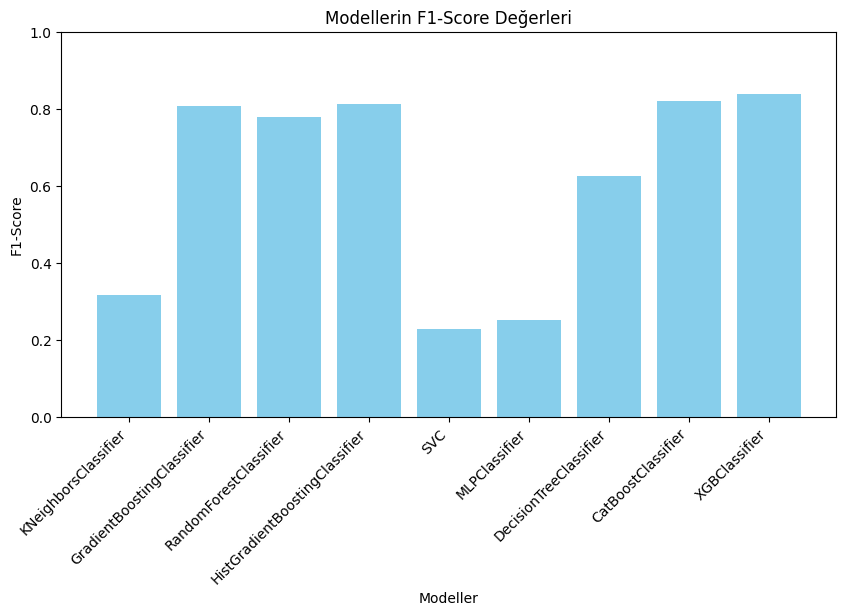

En iyi model: XGBClassifier
En iyi model (XGBClassifier) /content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_rfe_model_XGBClassifier.pkl dizinine kaydedildi.


'\nBu çalışmada, çeşitli makine öğrenmesi modelleri belirlenmiş ve değerlendirilmiştir.\nModeller, eğitim verisi kullanılarak fit edilmiş ve test verisi üzerinde tahminleme yapılmıştır.\nPerformans ölçümleri doğruluk ve F1-score hesaplanarak değerlendirilmiştir.\nElde edilen F1-score değerleri grafik üzerinde görselleştirilmiştir.\nEn iyi performansı gösteren model belirlenerek belirtilen dizine kaydedilmiştir.\nBöylece en iyi modelin daha sonra tekrar kullanılabilmesi sağlanmıştır.\n'

In [ ]:
# Model listesi ve hiperparametreleri tanımlama
models = [
    ("KNeighborsClassifier", KNeighborsClassifier()),
    ("GradientBoostingClassifier", GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=42)),
    ("RandomForestClassifier", RandomForestClassifier(n_estimators=100, random_state=42)),
    ("HistGradientBoostingClassifier", HistGradientBoostingClassifier(random_state=42)),
    ("SVC", SVC(kernel="rbf", probability=True, random_state=42)),
    ("MLPClassifier", MLPClassifier(hidden_layer_sizes=(20, 10), max_iter=500, random_state=42)),
    ("DecisionTreeClassifier", DecisionTreeClassifier(criterion='gini', max_depth=4, min_samples_split=4, random_state=42)),
    ("CatBoostClassifier", CatBoostClassifier(verbose=0, random_state=42)),
    ("XGBClassifier", XGBClassifier(use_label_encoder=False, eval_metric="logloss", random_state=42))
]

# F1-score sonuçlarını saklamak için bir sözlük oluşturma
f1_scores = {}
trained_models = {}

# Modelleri döngü ile çalıştır
for name, model in models:
    print(f"\nModel: {name}")

    # Pipeline oluşturma
    pipe = make_pipeline(model)

    # Modeli eğitme
    pipe.fit(X_train, y_train)
    trained_models[name] = pipe

    # Test verisi ile tahmin yapma
    y_pred = pipe.predict(X_test)

    # Doğruluk skoru hesapla
    accuracy = accuracy_score(y_test, y_pred)
    print(f"Doğruluk Skoru: {accuracy:.4f}")

    # Sınıflandırma raporu oluşturuluyor (ondalık hassasiyeti 4'e ayarlandı)
    report = classification_report(y_test, y_pred, digits=4)
    print("Sınıflandırma Raporu:")
    print(report)

    # F1-score hesapla ve kaydet
    f1 = f1_score(y_test, y_pred, average='weighted')
    f1_scores[name] = f1

# F1-score değerlerini görselleştirme
plt.figure(figsize=(10, 5))
plt.bar(f1_scores.keys(), f1_scores.values(), color='skyblue')
plt.xlabel("Modeller")
plt.ylabel("F1-Score")
plt.title("Modellerin F1-Score Değerleri")
plt.xticks(rotation=45, ha='right')
plt.ylim([0, 1])
plt.show()

# En iyi modeli seçme ve kaydetme
top_model_name = max(f1_scores, key=f1_scores.get)  # En yüksek F1-score'a sahip modeli seç
print(f"En iyi model: {top_model_name}")
top_model = trained_models[top_model_name]

# Model belirtilen dizine kaydediliyor
save_path = f"/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_rfe_model_{top_model_name}.pkl"
joblib.dump(top_model, save_path)
print(f"En iyi model ({top_model_name}) {save_path} dizinine kaydedildi.")

"""
Bu çalışmada, çeşitli makine öğrenmesi modelleri belirlenmiş ve değerlendirilmiştir.
Modeller, eğitim verisi kullanılarak fit edilmiş ve test verisi üzerinde tahminleme yapılmıştır.
Performans ölçümleri doğruluk ve F1-score hesaplanarak değerlendirilmiştir.
Elde edilen F1-score değerleri grafik üzerinde görselleştirilmiştir.
En iyi performansı gösteren model belirlenerek belirtilen dizine kaydedilmiştir.
Böylece en iyi modelin daha sonra tekrar kullanılabilmesi sağlanmıştır.
"""


# 11) PIPELINE OLUŞTURMA

- Colab veya JupyterLab ile yapılan denemelerde aşağıda oluşturulan Pipeline yapısı RAM yetmezliği nedeniyle çalıştırılamamıştır. Şimdiye kadar uygulanan veri ön işleme ve model oluşturma aşamaları bu Pipeline'da birleştirilmiştir.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OrdinalEncoder, StandardScaler
from sklearn.ensemble import ExtraTreesRegressor
from tsfresh import extract_features
from tsfresh.utilities.dataframe_functions import impute
from tsfresh.feature_extraction.settings import EfficientFCParameters, MinimalFCParameters
from tsfresh.utilities.dataframe_functions import impute
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier, HistGradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from sklearn.base import BaseEstimator, TransformerMixin

# TSFresh ile özellik çıkarımı yapan fonksiyon
def tsfresh_feature_extraction(data_frame):
    """
    Veriyi TSFresh kütüphanesi için uygun hale getirerek özellik çıkarımı yapar.
    """
    if isinstance(data_frame, np.ndarray):
        data_frame = pd.DataFrame(data_frame)  # Eğer veri ndarray formatındaysa DataFrame'e çevir

    reshaped_df = data_frame.melt(id_vars=['Date'], var_name='Ticker', Close_name='Close')
    reshaped_df['Ticker_encoded'] = reshaped_df['Ticker'].astype('Sector').cat.codes
    reshaped_df = reshaped_df.drop(columns=['Ticker'])

    extracted_features = extract_features(reshaped_df,
                                          column_id="Ticker_encoded",
                                          column_sort="Date",
                                          column_Close="Close",
                                          default_fc_parameters=EfficientFCParameters())
    extracted_features = impute(extracted_features)  # Eksik verileri doldur
    return extracted_features

# Özel TSFresh Transformer sınıfı
class TsfreshFeatureTransformer(BaseEstimator, TransformerMixin):
    def fit(self, input_data, target=None):
        return self  # Fit adımı gereksiz, sadece placeholder

    def transform(self, input_data):
        return tsfresh_feature_extraction(input_data)  # Özellik çıkarım fonksiyonunu çağır

# Veri ön işleme adımları
category_encoder = OrdinalEncoder()
data_imputer = IterativeImputer(estimator=ExtraTreesRegressor(n_estimators=10, random_state=42))
data_scaler = StandardScaler()

# Kolon bazlı ön işleme
data_preprocessor = ColumnTransformer(
    transformers=[
        ('date_encoder', category_encoder, ['Date']),  # Tarih verisini kategorik olarak encode et
        ('impute_and_scale', Pipeline(steps=[('impute', data_imputer), ('scale', data_scaler)]), slice(1, None))  # Sayısal veriler için imputasyon ve ölçeklendirme
    ]
)

# Pipeline oluşturulması
data_pipeline = Pipeline([
    ('preprocessing', data_preprocessor),  # Ön işleme
    ('tsfresh_features', TsfreshFeatureTransformer()),  # TSFresh özellik çıkarımı
    ('feature_selector', RFE(RandomForestClassifier(random_state=42)))  # Özellik seçimi
])

# Kullanılacak modeller
models = [
    ("KNeighborsClassifier", KNeighborsClassifier()),
    ("GradientBoostingClassifier", GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=42)),
    ("RandomForestClassifier", RandomForestClassifier(n_estimators=100, random_state=42)),
    ("HistGradientBoostingClassifier", HistGradientBoostingClassifier(random_state=42)),
    ("SVC", SVC(kernel="rbf", probability=True, random_state=42)),
    ("MLPClassifier", MLPClassifier(hidden_layer_sizes=(20, 10), max_iter=500, random_state=42)),
    ("DecisionTreeClassifier", DecisionTreeClassifier(criterion='gini', max_depth=4, min_samples_split=4, random_state=42)),
    ("CatBoostClassifier", CatBoostClassifier(verbose=0, random_state=42)),
    ("XGBClassifier", XGBClassifier(use_label_encoder=False, eval_metric="logloss", random_state=42))
]

# En iyi modeli eğiten fonksiyon
def train_optimal_model(input_features, target_labels):
    """
    En iyi modeli belirleyip eğitir.
    """
    transformed_features = data_pipeline.fit_transform(input_features)  # Ön işleme ve özellik mühendisliği

    # Eğitim ve test setlerine ayırma
    X_train, X_test, y_train, y_test = train_test_split(transformed_features, target_labels, test_size=0.2, random_state=42)

    optimal_model, highest_score = None, 0

    # Modelleri değerlendir
    for model_name, classifier in models:
        classifier.fit(X_train, y_train)
        score = classifier.score(X_test, y_test)

        # En iyi modeli belirle
        if score > highest_score:
            highest_score = score
            optimal_model = classifier

    return optimal_model

# Modeli eğitme fonksiyonunu çağır
#best_model = train_optimal_model(X, y)
best_model = XGBClassifier(use_label_encoder=False, eval_metric="logloss", random_state=42)

# En iyi modeli içeren pipeline oluşturma
final_pipeline = Pipeline([
    ('preprocessing', data_preprocessor),
    ('tsfresh_features', TsfreshFeatureTransformer()),
    ('feature_selector', RFE(RandomForestClassifier(random_state=42))),
    ('best_model', best_model)
])

final_pipeline

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('date_encoder',
                                                  OrdinalEncoder(), ['Date']),
                                                 ('impute_and_scale',
                                                  Pipeline(steps=[('impute',
                                                                   IterativeImputer(estimator=ExtraTreesRegressor(n_estimators=10,
                                                                                                                  random_state=42))),
                                                                  ('scale',
                                                                   StandardScaler())]),
                                                  slice(1, None, None))])),
                ('tsfresh_features', TsfreshFeatureTransformer()),
                ('feature_sel...
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None, random_state=42, ...))])

# 12) EN İYİ MODELİN TEST EDİLMESİ

- En iyi model, RandomForestClassifier(RFE) ile seçilen feature'ler ile eğitilen XGBClassifier modeli olmuştur.

- Öncelikle bu model cross-validation yöntemi ile tekrar eğitilecektir. En iyi performansı sağlamak için bu eğitim verisetinin tamamı kullanılarak yapılacaktır.

**12.1) XGBCLASSIFIER MODELİNİN CROSS-VALIDATION KULLANILARAK TÜM VERİSETİ İLE BAŞTAN EĞİTİLMESİ**

In [ ]:
import pandas as pd
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
import joblib
from tqdm import tqdm


x_data = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/rfe_selected_data.csv")

data = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/scaled_data.csv')
gruplanmıs_veri = data.groupby("Ticker_encoded")["Sector"].first().reset_index()  # Symbol sütununa göre gruplama

# Özellikler (X) ve hedef değişken (y) olarak ayırma
X = x_data
y = gruplanmıs_veri['Sector']


In [ ]:
# XGBClassifier modeli
xgb = XGBClassifier(use_label_encoder=False, eval_metric="logloss", random_state=42)

print("Model eğitimi başlatılıyor...")
for i in tqdm(range(1, 101), desc="Model Eğitimi % Tamamlandı"):
    if i == 1:
        xgb.fit(X, y)

# Çapraz doğrulama
cv_scores = cross_val_score(xgb, X, y, cv=5, scoring='accuracy', n_jobs=-1)
print(f"Çapraz doğrulama skorları: {cv_scores}")
print(f"Ortalama doğruluk: {cv_scores.mean()}")

# Modeli kaydetme
save_path = f"/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_fullData_XGB_model.pkl"
joblib.dump(xgb, save_path)
print("En iyi model kaydedildi.")


Model eğitimi başlatılıyor...


Model Eğitimi % Tamamlandı:   0%|          | 0/100 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [22:00:55] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
Model Eğitimi % Tamamlandı: 100%|██████████| 100/100 [00:17<00:00,  5.78it/s]


Çapraz doğrulama skorları: [0.82424242 0.78787879 0.78723404 0.7993921  0.79635258]
Ortalama doğruluk: 0.7990199871050936
En iyi model kaydedildi.


**12.2) REAL-ESTATE SEKTÖRÜNE AİT VERİNİN ÖN İŞLEME ADIMLARINDAN GEÇİRİLMESİ VE EN İYİ MODEL İLE TAHMİNLENMESİ**

In [ ]:
import yfinance as yf
import time
import pandas as pd

In [ ]:
real_estate_symbol = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/stock_sectors/real-estate.csv').Symbol

In [ ]:
# Boş (NaN) değerlerin sayısını hesaplayan fonksiyon
def count_missing_values(df, sector_name):
    missing_count = df.isna().sum().sum()
    print(f"{sector_name} sektöründe toplam {missing_count} boş değer bulunmaktadır.")

# boş değerleri kontrol etme
count_missing_values(real_estate_symbol, "Real-Estate")

Real-Estate sektöründe toplam 0 boş değer bulunmaktadır.


In [ ]:
def download_sector_data(ticker_list, sector, start_date='2005-01-01', end_date='2025-02-01', batch_size=100, delay=25):
    """
    Belirtilen sektöre ait hisse senetlerinin verilerini parti halinde indirir ve CSV dosyalarına kaydeder.

    Parametreler:
    ticker_list (list): İndirilecek hisse senedi sembollerinin listesi.
    sector (str): Sektör adı
    start_date (str): Veri indirme başlangıç tarihi
    end_date (str): Veri indirme bitiş tarihi
    batch_size (int): Her indirme partisindeki hisse senedi sayısı
    delay (int): Her parti arasında bekleme süresi

    Dönüş:
    Tuple (data_close, data_monthly_mom): Günlük kapanış fiyatları ve aylık momentum verileri.
    """
    print(f"\n### Downloading data for {sector.upper()} sector ###\n")
    all_data = []

    # Hisse senetlerini belirlenen batch_size boyutunda parçalara bölerek indir
    for i in range(0, len(ticker_list), batch_size):
        batch_tickers = ticker_list[i:i+batch_size]
        print(f"Downloading batch {i//batch_size + 1}: {len(batch_tickers)} tickers")

        # Yfinance kullanarak hisse verilerini indir
        data = yf.download(batch_tickers, start=start_date, end=end_date)
        all_data.append(data)

        # API limitlerine takılmamak için belirlenen süre kadar bekle
        time.sleep(delay)

    # Tüm partileri birleştir
    data = pd.concat(all_data, axis=1)

    # Kapanış fiyatlarını seç ve sütun isimlerini düzenle
    data_close = data[['Close']]
    data_close.columns = ['_'.join(col) for col in data_close.columns]

    # Aylık momentum hesapla
    data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1

    # Verileri ilgili CSV dosyalarına kaydet
    data_close.to_csv(f'/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/daily_data/daily_{sector}.csv')
    data_monthly_mom.to_csv(f'/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_{sector}.csv')

    print(f"\n### Data for {sector.upper()} sector downloaded and saved successfully ###\n")

    return data_close, data_monthly_mom


In [ ]:
data_real_estate = download_sector_data(real_estate_symbol.tolist(), "real_estate")


### Downloading data for REAL_ESTATE sector ###



[*********************100%***********************]  100 of 100 completed


[***                    6%                       ]  6 of 100 completedERROR:yfinance:Could not get exchangeTimezoneName for ticker 'SITC' reason: 'chart'
[*********************100%***********************]  100 of 100 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['SITC']: YFTzMissingError('$%ticker%: possibly delisted; no timezone found')
[                       0%                       ]

[*********************100%***********************]  62 of 62 completed
<ipython-input-27-cf31eddc63ba>:39: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  data_monthly_mom = data['Close'].resample('ME').last().pct_change() + 1



### Data for REAL_ESTATE sector downloaded and saved successfully ###



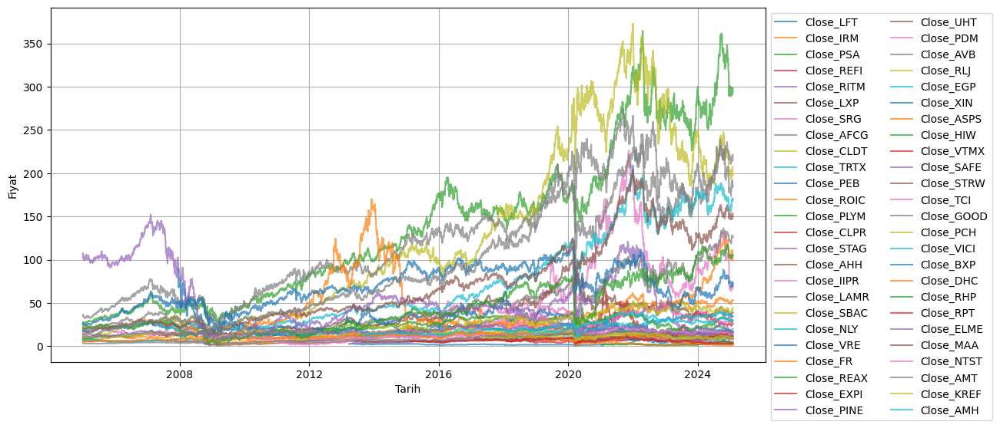

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Veriyi oku
data_close_real = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/daily_data/daily_real_estate.csv')

# 'Date' sütununu datetime formatına çevir
data_close_tech['Date'] = pd.to_datetime(data_close_tech['Date'])

# Şirket isimlerini al (Date sütunu hariç)
company_names = data_close_tech.columns[1:]

# Rastgele 50 şirket seç
selected_companies = np.random.choice(company_names, 50, replace=False)

# Grafik boyutunu belirle
plt.figure(figsize=(12, 6))

# Seçilen şirketleri plot et
for company in selected_companies:
    plt.plot(data_close_tech['Date'], data_close_tech[company], label=company, alpha=0.7)

# Grafik başlık ve etiketleri
plt.xlabel('Tarih')
plt.ylabel('Fiyat')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=2)  # Legend'i dışarı al
plt.grid(True)

# Grafiği göster
plt.show()


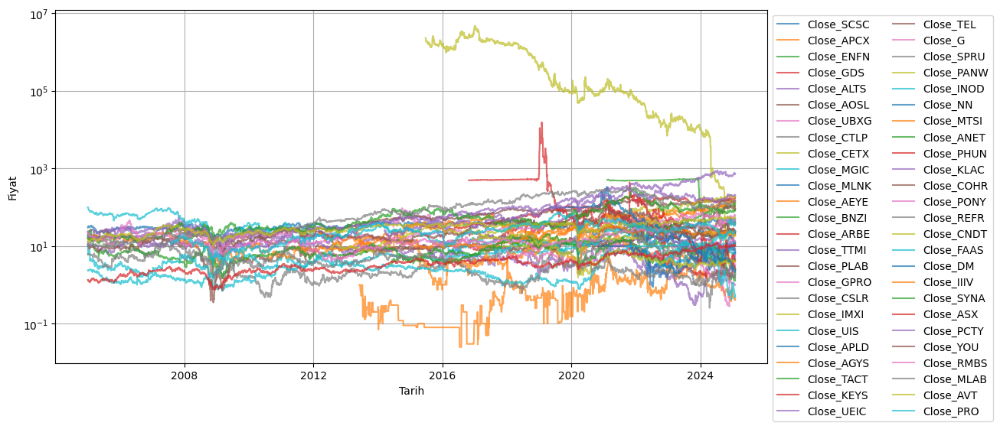

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Veriyi oku
data_close_real = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_real_estate.csv')

# 'Date' sütununu datetime formatına çevir
data_close_tech['Date'] = pd.to_datetime(data_close_tech['Date'])

# Şirket isimlerini al (Date sütunu hariç)
company_names = data_close_tech.columns[1:]

# Rastgele 50 şirket seç
selected_companies = np.random.choice(company_names, 50, replace=False)

# Grafik boyutunu belirle
plt.figure(figsize=(12, 6))

# Seçilen şirketleri plot et
for company in selected_companies:
    plt.plot(data_close_tech['Date'], data_close_tech[company], label=company, alpha=0.7)

#Büyük farkları daha anlaşılır hale getirmek için logaritmik ölçek kullan.
plt.yscale('log')

# Grafik başlık ve etiketleri
plt.xlabel('Tarih')
plt.ylabel('Fiyat')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=2)  # Legend'i dışarı al
plt.grid(True)

# Grafiği göster
plt.show()


In [ ]:
import pandas as pd

def clean_dataframe(file_path):
    df = pd.read_csv(file_path)  # CSV dosyasını oku
    initial_columns = df.shape[1]  # Başlangıçtaki sütun sayısını al
    threshold = 0.80 * len(df)  # Eksik veri eşiğini belirle (%80 ve daha fazla boş olan sütunlar çıkarılacak)

    # Eksik verisi eşiği aşan sütunları belirle
    removed_cols = [col for col in df.columns if df[col].isnull().sum() > threshold]

    # Belirlenen sütunları veri setinden çıkar
    df_cleaned = df.drop(columns=removed_cols)

    removed_columns = len(removed_cols)  # Çıkarılan sütun sayısını hesapla

    # Temizleme işlemi hakkında bilgi yazdır
    print(f"{file_path}: {removed_columns} sütun tespit edildi, kalan: {df_cleaned.shape[1]}\n")

    return df_cleaned  # Temizlenmiş veri setini döndür


real = clean_dataframe('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_real_estate.csv')

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_real_estate.csv: 38 sütun tespit edildi, kalan: 225



In [ ]:
import pandas as pd

def reduce_columns(file_path, target_columns=225):
    df = pd.read_csv(file_path)  # CSV dosyasını oku

    missing_counts = df.isnull().sum()  # Her sütundaki eksik veri sayısını hesapla
    sorted_columns = missing_counts.sort_values(ascending=False).index  # Eksik veri sayısına göre sütunları sırala

    # Eğer sütun sayısı hedeflenen sütun sayısından fazlaysa
    if df.shape[1] > target_columns:
        columns_to_drop = sorted_columns[:df.shape[1] - target_columns]  # En çok eksik veriye sahip sütunları belirle
        df_cleaned = df.drop(columns=columns_to_drop)  # Belirlenen sütunları veri setinden çıkar

        # İşlem hakkında bilgi yazdır
        print(f"{file_path}: {len(columns_to_drop)} sütun çıkarıldı, kalan: {df_cleaned.shape[1]}\n")

    else:
        df_cleaned = df  # Eğer sütun sayısı zaten hedefin altındaysa, veri seti değiştirilmez
        print(f"{file_path}: Sütun sayısı zaten {target_columns} veya daha az, değişiklik yapılmadı.")

    return df_cleaned  # Temizlenmiş veri setini döndür

real = reduce_columns('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_real_estate.csv')


/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/monthly_mom_data/monthly_mom_real_estate.csv: 38 sütun çıkarıldı, kalan: 225



In [ ]:
real.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_real.csv', index=False)

<ipython-input-53-367870269d21>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=missing_ratios_sorted[:70], y=missing_ratios_sorted.index[:70], palette="viridis")  # İlk 70 hisseyi çiz


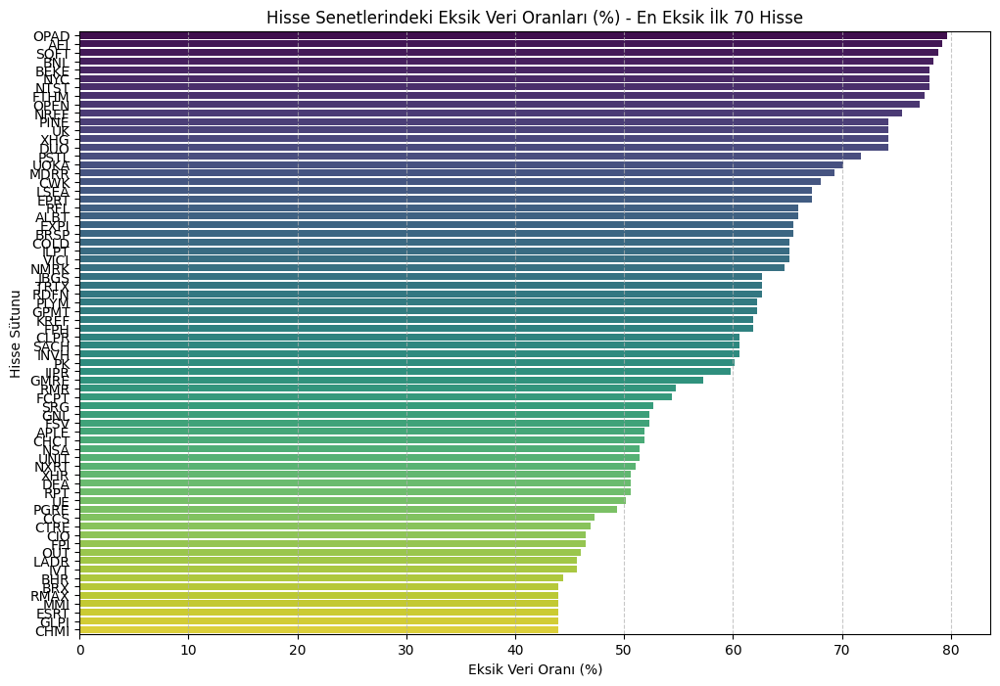

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Eksik veri oranlarını hesapla
missing_ratios = real.isnull().mean() * 100  # Yüzde cinsinden eksik veri oranı

# Eksik veri oranlarına göre büyükten küçüğe sırala
missing_ratios_sorted = missing_ratios.sort_values(ascending=False)

# Görselleştirme
plt.figure(figsize=(12, 8))
sns.barplot(x=missing_ratios_sorted[:70], y=missing_ratios_sorted.index[:70], palette="viridis")  # İlk 70 hisseyi çiz
plt.xlabel("Eksik Veri Oranı (%)")
plt.ylabel("Hisse Sütunu")
plt.title("Hisse Senetlerindeki Eksik Veri Oranları (%) - En Eksik İlk 70 Hisse")
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.show()


In [ ]:
import pandas as pd

real = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_real.csv')

# Her dosyayı uygun formatta dönüştürme
def combine(df):
    # 'Date' ve hisse sütunlarını 'Date', 'Ticker' ve 'Close' formatına getirme
    data_ready = pd.melt(df, id_vars=['Date'], var_name='Ticker', value_name='Close')
    return data_ready

# Her bir dosyayı dönüştür
real_combined = combine(real)

real_combined.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_combined.csv', index=False)

In [ ]:
import pandas as pd
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder

def encode_data(file_path, output_path):
    # CSV dosyasını oku
    df = pd.read_csv(file_path)

    # Tarih sütunu (ilk sütun) için Ordinal Encoding
    encoder_date = OrdinalEncoder()
    df.iloc[:, 0] = encoder_date.fit_transform(df.iloc[:, [0]])
    print(f"{file_path}: İlk sütundaki tarihler ordinal encoding ile dönüştürüldü.")

    # Ticker sütunu için Label Encoding
    if "Ticker" in df.columns:
        encoder_Ticker = LabelEncoder()
        df["Ticker_encoded"] = encoder_Ticker.fit_transform(df["Ticker"])
        df.drop(columns=["Ticker"], inplace=True)
        print(f"{file_path}: 'Ticker' sütunu Label Encoding ile dönüştürüldü ve orijinal sütun kaldırıldı.")

    # Dönüştürülmüş veriyi kaydet
    df.to_csv(output_path, index=False)
    print(f"Encoded CSV başarıyla kaydedildi: {output_path}")

# Kullanım
dosya_yolu = '/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_combined.csv'
cikti_yolu = '/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_encoded.csv'
encode_data(dosya_yolu, cikti_yolu)

/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_combined.csv: İlk sütundaki tarihler ordinal encoding ile dönüştürüldü.
/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_combined.csv: 'Ticker' sütunu Label Encoding ile dönüştürüldü ve orijinal sütun kaldırıldı.
Encoded CSV başarıyla kaydedildi: /content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_encoded.csv


In [ ]:
import pandas as pd
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge
from sklearn.model_selection import train_test_split
from sklearn.impute import IterativeImputer
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor

df = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_encoded.csv")

# Farklı modellerle imputing yapma fonksiyonu
def impute_Close_by_Ticker(df, model):
    imputer = IterativeImputer(estimator=model, initial_strategy='mean', random_state=0)

    # Her Ticker_encoded için ayrı ayrı işlem yap
    df_imputed = df.copy()
    for Ticker in df['Ticker_encoded'].unique():
        mask = df['Ticker_encoded'] == Ticker
        df_subset = df.loc[mask, ['Close']]

        # Imputer'ı fit ve transform et
        df_imputed.loc[mask, 'Close'] = imputer.fit_transform(df_subset)

    return df_imputed

In [ ]:
imputed_data = impute_Close_by_Ticker(df, models["ExtraTreesRegressor"])

In [ ]:
imputed_data.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_imputed.csv', index=False)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler


# Farklı Ticker_encoded değerlerine göre ayrı ayrı StandardScaler uygulama fonksiyonu
def scale_by_Ticker(df):
    scaler = StandardScaler()

    df_scaled = df.copy()  # Orijinal veri kaybolmasın diye bir kopya alıyoruz.

    # Her Ticker_encoded için işlem yap
    for Ticker in df['Ticker_encoded'].unique():
        # İlgili Ticker_encoded değerine göre veri alt kümesi seç
        mask = df['Ticker_encoded'] == Ticker
        df_subset = df.loc[mask, ['Close']]

        # StandardScaler'ı fit et ve dönüştür
        df_scaled.loc[mask, 'Close'] = scaler.fit_transform(df_subset[['Close']])

    return df_scaled

imputed_data = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_imputed.csv')

# StandardScaler uygulama
scaled_data = scale_by_Ticker(imputed_data)

# Sonuçları göster
print(scaled_data)

        Date     Close  Ticker_encoded
0        0.0  0.000000               1
1        1.0  0.121070               1
2        2.0 -0.140734               1
3        3.0 -0.048623               1
4        4.0  0.282846               1
...      ...       ...             ...
53979  236.0  3.782759             223
53980  237.0 -0.718214             223
53981  238.0 -0.980966             223
53982  239.0 -1.280384             223
53983  240.0  0.218939             223

[53984 rows x 3 columns]


In [ ]:
scaled_data.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_scaled.csv', index=False)

In [ ]:
import pandas as pd
from tsfresh import extract_features
from tsfresh.utilities.dataframe_functions import impute
from tsfresh.feature_extraction.settings import EfficientFCParameters, MinimalFCParameters

- Bu adım da Colab'de yaşanan uyumsuzluk nedeni ile JupyterLab üzerinden tamamlanmıştır.

In [ ]:
from tsfresh.feature_extraction import extract_features, EfficientFCParameters  # TSFresh kütüphanesinden özellik çıkarma fonksiyonlarını içe aktar

df = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/test_data/real_scaled.csv')  # Veriyi CSV dosyasından oku

# Özellikleri çıkar (TSFresh kullanarak)
features = extract_features(df,
                            column_id="Ticker_encoded",  # Hisse sembollerini belirten sütun
                            column_sort="Date",  # Verilerin zaman sırasına göre düzenlenmesini sağlayan sütun
                            column_value="Close",  # Özellik çıkarımının uygulanacağı fiyat verisi sütunu
                            default_fc_parameters=EfficientFCParameters())  # Verimli özellik çıkarma parametrelerini kullan

features = impute(features)  # Eksik değerleri doldur
print(features.head())  # İlk birkaç satırı ekrana yazdır


- 9. adımda yapılan Feature Selection işlemi sonucunda seçilen özniteliklerin aynılarını Real-Estate sektörü için de seçelim. Burada yeniden Feature Selection yapılmaz çünkü model ile predict yapılırken aynı öznitelikler kullanılmalıdır.

In [ ]:
import pandas as pd
feature_names = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/rfe_selected_data.csv')
feature_names_list = feature_names.columns.tolist()

real_estate_selected_features = features[feature_names_list]
real_estate_selected_features.to_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/test_data/real_selected_features.csv", index=False)

In [ ]:
import joblib
import pandas as pd
import numpy as np

# Kaydedilmiş modeli yükle
loaded_model = joblib.load("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/models/best_fullData_XGB_model.pkl")

# Test verisini yükle
data = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/features/test_data/real_selected_features.csv")

# Şirket isimlerini temizlenmiş veri setinden al
cleaned_data = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/cleaned_data/cleaned_real.csv")
company_names = list(cleaned_data.columns[1:])  # İlk sütun Date olduğu için onu atlıyoruz

# Tahmin olasılıklarını al
predictions_proba = loaded_model.predict_proba(data)

# Sonuçları DataFrame olarak oluştur
df_results = pd.DataFrame(predictions_proba, columns=["Technology", "Finance", "Healthcare"])
df_results.insert(0, "Ticker", company_names[:data.shape[0]])  # Şirket isimlerini ekle

# Yüzde formatına çevir
df_results.iloc[:, 1:] = df_results.iloc[:, 1:] * 100  # Yüzdelik çeviri
df_results.iloc[:, 1:] = df_results.iloc[:, 1:].round(2)  # Yuvarlama

# En yüksek sektör olasılığını bul ve ekle
df_results["Result"] = df_results.iloc[:, 1:].idxmax(axis=1)

df_results.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/test_results/result.csv')
df_results

,Ticker,Technology,Finance,Healthcare,Result
0,ABR,99.459999,0.220000,0.320000,Technology
1,ADC,88.879997,1.460000,9.660000,Technology
2,AGNC,98.709999,0.320000,0.960000,Technology
3,AKR,99.339996,0.090000,0.570000,Technology
4,AMH,81.040001,15.300000,3.670000,Technology
...,...,...,...,...,...
219,UK,99.949997,0.030000,0.020000,Technology
220,UOKA,86.930000,0.210000,12.870000,Technology
221,WHLR,0.030000,2.630000,97.349998,Healthcare
222,XHG,91.900002,0.600000,7.510000,Technology


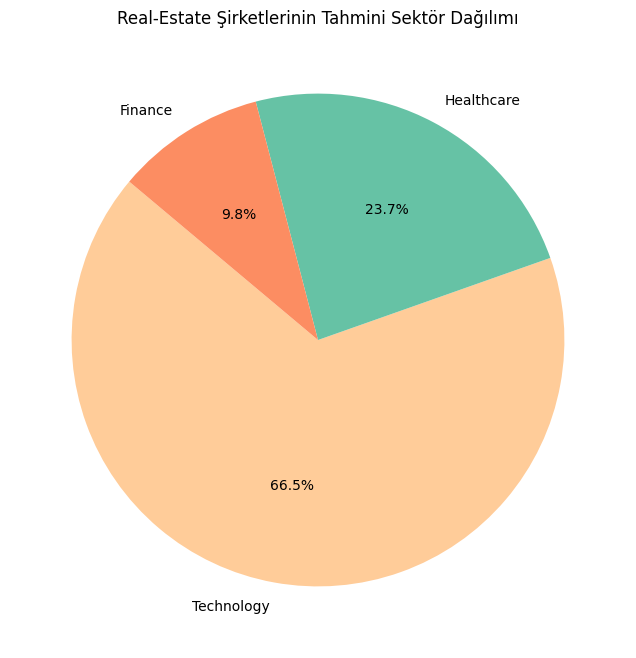

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Kaydedilen sonuçları yükle
df_results = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/test_results/result.csv')

# Result sütunundaki sektör dağılımını hesapla
sector_counts = df_results['Result'].value_counts()

# Pasta grafiğini oluştur
plt.figure(figsize=(8, 8))
plt.pie(sector_counts, labels=sector_counts.index, autopct='%1.1f%%', startangle=140, colors=['#ffcc99','#66c2a5','#fc8d62'])
plt.title('Real-Estate Şirketlerinin Tahmini Sektör Dağılımı')

# Grafiği göster
plt.show()


# 13) BONUS

- Bu kısımda momentum, volatilite, RSI, MACD gibi faktörlerin çıkarılması ile ilgili adımlar yer almaktadır.
- Öncelikle tsfresh formatındaki veri tekrar eski sütun bazlı formata dönüştürülmüş ve her ticker için faktörler hesaplanmıştır.
- Bu aşamaların sonucunda verinin sütun sayısı çok fazla arttığından daha sonra gelen Imputing aşamasında RAM yetmezliği problemi oluşmuştur. Bu nedenle faktörlerin dahil edildiği eğitim aşaması Imputing'den öteye götürülememiştir.

In [ ]:
import pandas as pd

# Veriyi yükleyelim
df = pd.read_csv("/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/preprocessing/imputed_data.csv")

# 'sector' sütununu çıkar
df = df.drop(columns=['Sector'])

# Veriyi geniş formatta pivotla
df_pivot = df.pivot(index='Date', columns='Ticker_encoded', values='Close')

# Date sütununu geri ekleyelim
df_pivot.reset_index(inplace=True)

df_pivot.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/bonus/column_based_data.csv', index=False)

In [ ]:
!pip install ta

  Preparing metadata (setup.py) ... done
  Created wheel for ta: filename=ta-0.11.0-py3-none-any.whl size=29412 sha256=55ea0727ebc4c9f1f04b829504d651e57a1fe28cd4b9e2c6f81f9833ff18f0a1
  Stored in directory: /root/.cache/pip/wheels/a1/d7/29/7781cc5eb9a3659d032d7d15bdd0f49d07d2b24fec29f44bc4
Successfully built ta


In [ ]:
import pandas as pd
import ta  # Teknik analiz kütüphanesi

# Veriyi yükleyelim
df_pivot = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/bonus/column_based_data.csv')

# Date sütununu datetime formatına çevir (eğer değilse)
#df_pivot['Date'] = pd.to_datetime(df_pivot['Date'])

def calculate_factors(df):
    # Yeni DataFrame oluşturacağız, burada sadece teknik göstergeler olacak
    new_columns = []

    for col in df.columns:
        if col != "Date":  # Sadece fiyat sütunları için uygula
            # Momentum hesapla
            new_columns.append(df[col].diff().rename(f"momentum_{col}"))

            # Volatilite hesapla
            new_columns.append(df[col].rolling(window=14).std().rename(f"volatility_{col}"))

            # RSI hesapla
            new_columns.append(ta.momentum.RSIIndicator(df[col], window=14).rsi().rename(f"rsi_{col}"))

            # MACD hesapla
            macd = ta.trend.MACD(df[col])
            new_columns.append(macd.macd().rename(f"macd_{col}"))
            new_columns.append(macd.macd_signal().rename(f"macd_signal_{col}"))

    # Yeni sütunları orijinal df'ye ekle
    df_factors = pd.concat([df] + new_columns, axis=1)
    return df_factors


# Faktörleri hesapla
df_factors = calculate_factors(df_pivot)

# Yeni dataframe'i CSV olarak kaydet
df_factors.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/bonus/factored_data.csv', index=False)

# Sonucu göster
print(df_factors.head())


   Date         0         1         2         3         4         5         6  \
0   0.0  1.013668  1.006220  1.010851  1.043245  1.026452  1.010135  1.017236   
1   1.0  1.085481  0.990131  1.010851  1.043245  1.166710  1.064829  1.017236   
2   2.0  0.925000  1.006645  1.010851  1.043245  0.928889  1.002552  1.017236   
3   3.0  0.934685  0.986799  1.010851  1.043245  0.865370  0.953128  1.017236   
4   4.0  1.157109  1.003345  1.010851  1.043245  1.102608  1.022969  1.017236   

          7         8  ...  momentum_1645  volatility_1645  rsi_1645  \
0  1.012822  1.002013  ...            NaN              NaN       NaN   
1  1.057031  1.081784  ...            0.0              NaN       NaN   
2  0.950265  0.855670  ...            0.0              NaN       NaN   
3  1.030195  1.004016  ...            0.0              NaN       NaN   
4  1.020115  0.952000  ...            0.0              NaN       NaN   

   macd_1645  macd_signal_1645  momentum_1646  volatility_1646  rsi_1646  \
0   

In [ ]:
import pandas as pd
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.neighbors import KNeighborsRegressor

# Temizlenmiş CSV dosyasını oku
df_factors_cleaned = pd.read_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/bonus/factored_data.csv')

# Burada tüm sütunları kullanacağız, eğer hedef bir sütun varsa ona göre değiştirebilirsiniz
X = df_factors_cleaned

# IterativeImputer kullanarak eksik değerleri doldur
imputer = IterativeImputer(estimator=KNeighborsRegressor(n_neighbors=5), max_iter=10, random_state=42)

# Modeli eğitip, eksik değerleri doldur
X_imputed = imputer.fit_transform(X)

# İmputed (eksik değeri doldurulmuş) DataFrame'e dönüştür
df_imputed = pd.DataFrame(X_imputed, columns=X.columns)

# İmputed veriyi yeni bir CSV olarak kaydet
#df_imputed.to_csv('/content/drive/MyDrive/VeriYogunUygulamalar-Yuklemeler/data/bonus/factored_imputed_data.csv', index=False)

# Sonuç: İmputed dataframe'in ilk 5 satırını göster
print(df_imputed.head())
